# Discrete Wavelet Transform (DWT)

The Discrete Wavelet Transform (DWT) is a signal/image processing technique commonly applied for denoising and compression. As with other Wavelet Transforms, the DWT overcomes the time-frequency trade-off characteristic of the Fourier Transform by scaling and translating a mother wavelet along the length of the non-stationary time-series. In this way, the signal is decomposed into temporally localized wavelet coefficients which represent its spectral composition at different frequency bands. The main difference from the Continuous Wavelet Transform (CWT) is that the DWT applies a finite set of wavelet functions (filter banks) at specific scales and translations, thereby decomposing the signal into discretized frequency bands.

### Citation:
The Stratton seismic data used in this notebook was collected and made available for worldwide education and training by the Bureau of Economic Geology at the University of Texas at Austin. It can be downloaded from the SEG Wiki Open Data directory https://wiki.seg.org/wiki/Stratton_3D_survey

In [1]:
# pip install pathlib
# pip install segysak
# pip install PyWavelets

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pathlib
import segysak
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

### Load Seismic Data

In [3]:
ST3D_path = pathlib.Path('Stratton3D_32bit.sgy')
ST3D_path

WindowsPath('Stratton3D_32bit.sgy')

In [4]:
from segysak.segy import get_segy_texthead

In [5]:
get_segy_texthead(ST3D_path)

Text HeaderC01 STRATTON 3D Data Set
C02
C03 32-bit 3-D Volume
C04
C05
C06 DATA FORMAT      : IBM FLOATING POINT
C07
C08 HEADER PARAMETER VALUE LOCATIONS:
C09 PARAMETER NAME       HEADER CONTAINING VALUE    BYTE RANGE
C10 ==========================================================
C11   LINE NUMBER          BINARY                       5 - 8
C12   DATA FORMAT CODE     BINARY                      25 - 26
C13
C14   LINE NUMBER          TRACE                        9 - 12
C15   CDP NUMBER           TRACE                       21 - 24
C16   X LOCATION           TRACE                       73 - 76
C17   Y LOCATION           TRACE                       77 - 80
C18   X LOCATION           TRACE                       81 - 84
C19   Y LOCATION           TRACE                       85 - 88
C20   START TIME           TRACE                      109 - 110
C21   NUMBER OF SAMPLES    TRACE                      115 - 116
C22   SAMPLE RATE (USEC)   TRACE                      117 - 118
C23
C24
C25
C26
C27
C28
C29
C30
C31
C32
C33
C34
C35
C36
C37
C38
C39 written from EGLTools for Matlab on 16-Mar-2007
C40  EGL Archive Copy

In [6]:
from segysak.segy import segy_header_scan

In [7]:
scan = segy_header_scan(ST3D_path)
scan[scan['std']>0]

,byte_loc,count,mean,std,min,25%,50%,75%,max
TRACE_SEQUENCE_LINE,1,1000.0,109.5,67.206895,1.0,50.75,105.5,168.00,230.0
FieldRecord,9,1000.0,3.7,1.269493,2.0,3.00,4.0,5.00,6.0
CDP,21,1000.0,109.5,67.206895,1.0,50.75,105.5,168.00,230.0
SourceX,73,1000.0,2187777.5,3696.379238,2181150.0,2184560.00,2187997.5,2191008.75,2193745.0
SourceY,77,1000.0,705643.5,69.822096,705550.0,705605.00,705660.0,705715.00,705770.0
GroupX,81,1000.0,2187777.5,3696.379238,2181150.0,2184560.00,2187997.5,2191008.75,2193745.0
GroupY,85,1000.0,705643.5,69.822096,705550.0,705605.00,705660.0,705715.00,705770.0


In [8]:
from segysak.segy import segy_loader, well_known_byte_locs

In [9]:
ST3D_volume = segy_loader(ST3D_path, iline=9, xline=21, cdpx=81, cdpy=85, vert_domain='TWT')
ST3D_volume


Loading as 3D
Fast direction is CDP


<xarray.Dataset>
Dimensions:  (iline: 309, twt: 1501, xline: 230)
Coordinates:
  * iline    (iline) int32 2 3 4 5 6 7 8 9 ... 303 304 305 306 307 308 309 310
  * xline    (xline) int32 1 2 3 4 5 6 7 8 9 ... 223 224 225 226 227 228 229 230
  * twt      (twt) float64 0.0 2.0 4.0 6.0 ... 2.996e+03 2.998e+03 3e+03
    cdp_x    (iline, xline) float64 2.194e+06 2.194e+06 ... 2.181e+06 2.181e+06
    cdp_y    (iline, xline) float64 7.056e+05 7.056e+05 ... 7.225e+05 7.225e+05
Data variables:
    data     (iline, xline, twt) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
Attributes:
    ns:                  None
    sample_rate:         2.0
    text:                C01 STRATTON 3D Data Set\nC02\nC03 32-bit 3-D Volume...
    measurement_system:  ft
    d3_domain:           None
    epsg:                None
    corner_points:       None
    corner_points_xy:    None
    source_file:         Stratton3D_32bit.sgy
    srd:                 None
    datatype:            None
    percentiles:         [-0.14259597518499442, -0.12317047291315068, -0.0344...
    coord_scalar:        None

In [10]:
binsize_x = np.diff(ST3D_volume.cdp_x, axis=1)[0]
binsize_y = np.diff(ST3D_volume.cdp_y, axis=0)[0]
timestep_z = np.diff(ST3D_volume.twt)[0]
print('Binsize X: {}'.format(binsize_x[0]), '\n' 'Binsize Y: {}'.format(binsize_y[0]), '\n' 
      'Sample Interval: {}'.format(timestep_z))

Binsize X: -55.0 
Binsize Y: 55.0 
Sample Interval: 2.0


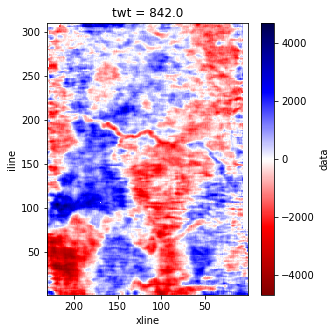

In [11]:
fig, ax = plt.subplots(figsize=(4.5,5))
ST3D_volume.data.sel(twt=842).plot.imshow(ax=ax, cmap='seismic_r')
ax.invert_xaxis()

In [12]:
ST3D_volume_df = ST3D_volume.to_dataframe()
ST3D_volume_df

data      cdp_x     cdp_y
iline twt    xline                           
2     0.0    1       0.0  2193745.0  705550.0
             2       0.0  2193690.0  705550.0
             3       0.0  2193635.0  705550.0
             4       0.0  2193580.0  705550.0
             5       0.0  2193525.0  705550.0
...                  ...        ...       ...
310   3000.0 226     0.0  2181370.0  722490.0
             227     0.0  2181315.0  722490.0
             228     0.0  2181260.0  722490.0
             229     0.0  2181205.0  722490.0
             230     0.0  2181150.0  722490.0

[106676070 rows x 3 columns]

In [13]:
ST3D_volume_df_rsidx = ST3D_volume_df.reset_index()
ST3D_volume_df_rsidx

,iline,twt,xline,data,cdp_x,cdp_y
0,2,0.0,1,0.0,2193745.0,705550.0
1,2,0.0,2,0.0,2193690.0,705550.0
2,2,0.0,3,0.0,2193635.0,705550.0
3,2,0.0,4,0.0,2193580.0,705550.0
4,2,0.0,5,0.0,2193525.0,705550.0
...,...,...,...,...,...,...
106676065,310,3000.0,226,0.0,2181370.0,722490.0
106676066,310,3000.0,227,0.0,2181315.0,722490.0
106676067,310,3000.0,228,0.0,2181260.0,722490.0
106676068,310,3000.0,229,0.0,2181205.0,722490.0


### Extract 1D Signal

Trace - Iline 2 / Xline 1

In [14]:
signal = ST3D_volume_df_rsidx[ST3D_volume_df_rsidx.iline==2]
signal = signal[signal.xline==1]
signal = signal.data.values
signal.shape

(1501,)

In [15]:
time = ST3D_volume_df_rsidx[ST3D_volume_df_rsidx.iline==2]
time = time[time.xline==1]
time = time.twt.values
time.shape

(1501,)

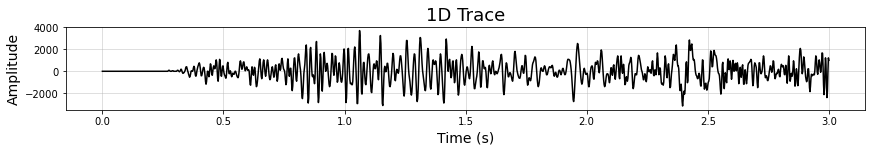

In [16]:
fig, ax = plt.subplots(figsize=(12,2), constrained_layout=True)
ax.plot(time/1e3, signal, color='k')
ax.set_xlabel('Time (s)', size=14)
ax.set_ylabel('Amplitude', size=14)
ax.set_title('1D Trace', size=18)
ax.grid(alpha=0.5)

### Extract 2D Signal

Slice - TWT 842

In [17]:
signal_2D = ST3D_volume_df_rsidx[ST3D_volume_df_rsidx.twt==842]
signal_2D = signal_2D.data.values
signal_2D = signal_2D.reshape(309, 230)
signal_2D.shape

(309, 230)

In [18]:
iline_2D = ST3D_volume_df_rsidx[ST3D_volume_df_rsidx.twt==842]
iline_2D = iline_2D.iline.values
iline_2D = iline_2D.reshape(309, 230)
iline_2D.shape

(309, 230)

In [19]:
xline_2D = ST3D_volume_df_rsidx[ST3D_volume_df_rsidx.twt==842]
xline_2D = xline_2D.xline.values
xline_2D = xline_2D.reshape(309, 230)
xline_2D.shape

(309, 230)

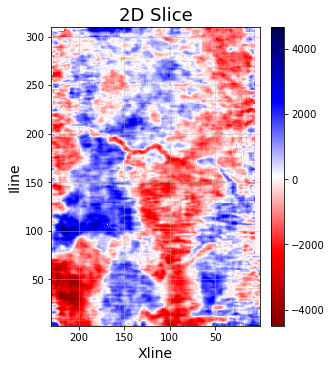

In [20]:
fig, ax = plt.subplots(figsize=(4.5,5), constrained_layout=True)
im = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap='seismic_r')
ax.set_xlim([np.amin(xline_2D), np.amax(xline_2D)])
ax.set_ylim([np.amin(iline_2D), np.amax(iline_2D)])
ax.set_xlabel('Xline', size=14)
ax.set_ylabel('Iline', size=14)
ax.set_title('2D Slice', size=18)
ax.invert_xaxis()
ax.grid(alpha=0.5)
fig.colorbar(im, ax=ax)

### Extract 3D Signal

Full Volume

In [21]:
signal_3D = ST3D_volume_df_rsidx
signal_3D = signal_3D.data.values
signal_3D = signal_3D.reshape(309, 1501, 230)
signal_3D = signal_3D.transpose(0, 2, 1)
signal_3D.shape

(309, 230, 1501)

In [22]:
iline_3D = ST3D_volume_df_rsidx
iline_3D = iline_3D.iline.values
iline_3D = iline_3D.reshape(309, 1501, 230)
iline_3D = iline_3D.transpose(0, 2, 1)
iline_3D.shape

(309, 230, 1501)

In [23]:
xline_3D = ST3D_volume_df_rsidx
xline_3D = xline_3D.xline.values
xline_3D = xline_3D.reshape(309, 1501, 230)
xline_3D = xline_3D.transpose(0, 2, 1)
xline_3D.shape

(309, 230, 1501)

In [24]:
twt_3D = ST3D_volume_df_rsidx
twt_3D = twt_3D.twt.values
twt_3D = twt_3D.reshape(309, 1501, 230)
twt_3D = twt_3D.transpose(0, 2, 1)
twt_3D.shape

(309, 230, 1501)

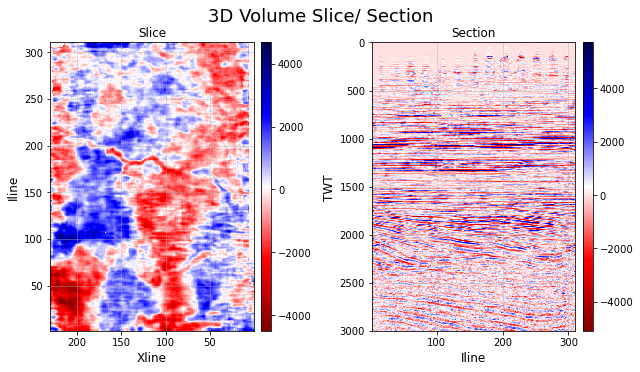

In [25]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(9,5), gridspec_kw={'width_ratios':[4,4]}, constrained_layout=False)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap='seismic_r')
        ax.set_xlabel('Xline', size=12)
        ax.set_ylabel('Iline', size=12)
        ax.set_title('Slice', size=12)
        ax.invert_xaxis()
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(iline_3D[:,110-1,:], twt_3D[:,110-1,:], signal_3D[:,110-1,:], shading='auto', cmap='seismic_r')
        ax.set_xlabel('Iline', size=12)
        ax.set_ylabel('TWT', size=12)
        ax.set_title('Section', size=12)
        ax.invert_yaxis()
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
fig.text(0.5,1.0, '3D Volume Slice/ Section', ha='center', va='center', size=18)
plt.tight_layout()

### Daubechies Wavelets

In [26]:
import pywt

View Daubechies wavelet types

In [27]:
db_waveletlist = pywt.wavelist(family='db')
print(db_waveletlist)

['db1', 'db2', 'db3', 'db4', 'db5', 'db6', 'db7', 'db8', 'db9', 'db10', 'db11', 'db12', 'db13', 'db14', 'db15', 'db16', 'db17', 'db18', 'db19', 'db20', 'db21', 'db22', 'db23', 'db24', 'db25', 'db26', 'db27', 'db28', 'db29', 'db30', 'db31', 'db32', 'db33', 'db34', 'db35', 'db36', 'db37', 'db38']


View properties of Daubechies 1 wavelet

In [28]:
db1_wavelet = pywt.Wavelet('db1')
print(db1_wavelet)

Wavelet db1
  Family name:    Daubechies
  Short name:     db
  Filters length: 2
  Orthogonal:     True
  Biorthogonal:   True
  Symmetry:       asymmetric
  DWT:            True
  CWT:            False


### Single-level 1D DWT

In [29]:
coeff_len = pywt.dwt_coeff_len(data_len=1501, filter_len=2, mode='zero')
coeff_len

751

In [30]:
cA, cD = pywt.dwt(signal, wavelet='db1', mode='zero')

In [31]:
tl = np.linspace(0,3,751)

Text(0.5, 0.98, 'Single-level DWT (db1)')

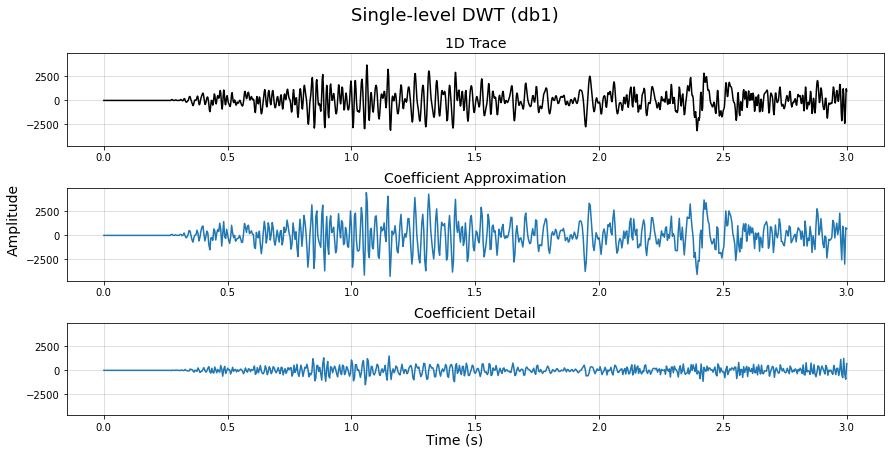

In [32]:
fig, axs = plt.subplots(figsize=(12,6), nrows=3, sharey=True, constrained_layout=True)
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_title('1D Trace', size=14)
axs[0].grid(alpha=0.5)
axs[1].plot(tl, cA)
axs[1].set_title('Coefficient Approximation', size=14)
axs[1].grid(alpha=0.5)
axs[2].plot(tl, cD)
axs[2].set_title('Coefficient Detail', size=14)
axs[2].grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-level DWT (db1)', size=18)

##### Resample using nearest spline interpolation

In [33]:
from scipy.interpolate import interp1d

In [34]:
len(cA), len(cD)

(751, 751)

In [35]:
int_cA = interp1d(tl, cA, kind='nearest')
int_cD = interp1d(tl, cD, kind='nearest')
cA_r = int_cA(time/1e3)
cD_r = int_cD(time/1e3)
[min(cA), min(cA_r)], [max(cA), max(cA_r)], [min(cD), min(cD_r)], [max(cD), max(cD_r)]

([-4263.8535, -4263.8535],
 [4454.7725, 4454.7725],
 [-1495.5308, -1495.5308],
 [1495.5308, 1495.5308])

In [36]:
len(cA_r), len(cD_r)

(1501, 1501)

In [37]:
c_lst_r = [cA_r, cD_r]

Text(0.5, 0.98, 'Resampled Single-level DWT (db1)')

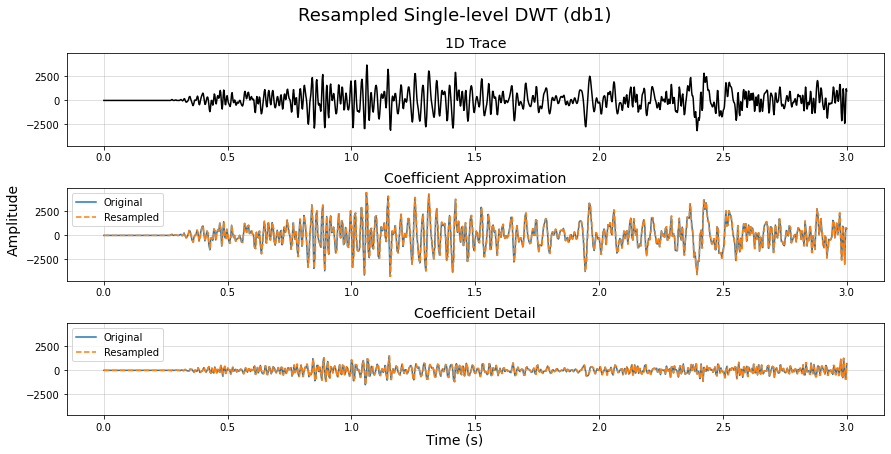

In [38]:
fig, axs = plt.subplots(figsize=(12,6), nrows=3, sharey=True, constrained_layout=True)
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_title('1D Trace', size=14)
axs[0].grid(alpha=0.5)
axs[1].plot(tl, cA, lw=1.5)
axs[1].plot(time/1e3, c_lst_r[0], '--')
axs[1].set_title('Coefficient Approximation', size=14)
axs[1].grid(alpha=0.5)
axs[1].legend(['Original', 'Resampled'])
axs[2].plot(tl, cD, lw=1.5)
axs[2].plot(time/1e3, c_lst_r[1], '--')
axs[2].set_title('Coefficient Detail', size=14)
axs[2].grid(alpha=0.5)
axs[2].legend(['Original', 'Resampled'])
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Resampled Single-level DWT (db1)', size=18)

### Inverse Single-level 1D DWT

In [39]:
inv_signal = pywt.idwt(cA, cD, wavelet='db1', mode='zero') 

In [40]:
signal.shape, inv_signal.shape

((1501,), (1502,))

In [41]:
inv_int = interp1d(np.linspace(0,3,inv_signal.shape[0]), inv_signal, kind='nearest')
inv_signal = inv_int(time/1e3)
min(signal), min(inv_signal), max(signal), max(inv_signal)

(-3150.0, -3150.0, 3690.0, 3689.9995)

In [42]:
signal.shape, inv_signal.shape

((1501,), (1501,))

Text(0.5, 0.98, 'Inverse Single-level DWT (db1)')

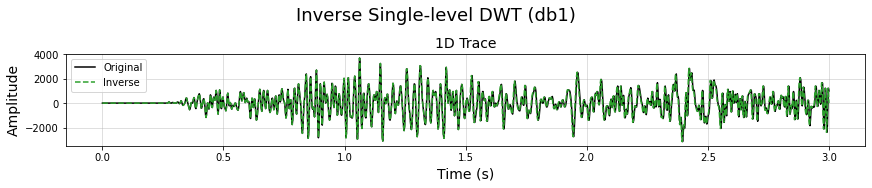

In [43]:
fig, ax = plt.subplots(figsize=(12,2.5), constrained_layout=True)
ax.plot(time/1e3, signal, color='k')
ax.plot(time/1e3, inv_signal, '--', color='tab:green')
ax.set_title('1D Trace', size=14)
ax.grid(alpha=0.5)
ax.legend(['Original', 'Inverse'])
ax.set_xlabel('Time (s)', size=14)
ax.set_ylabel('Amplitude', size=14)
plt.suptitle('Inverse Single-level DWT (db1)', size=18)

### Multi-level 1D DWT

In [44]:
max_level = pywt.dwt_max_level(data_len=1501, filter_len=2)
max_level

10

In [45]:
c_m = pywt.wavedec(signal, wavelet='db1', mode='zero', level=max_level)

In [46]:
def Reverse(lst):
    lst.reverse()
    return lst

In [47]:
cA_m = c_m[0]
rD = Reverse(c_m[1:])
cD_m_lst = [item for item in rD]

In [48]:
tl_m = []

for level in range(len(c_m)):
    tl_m.append(np.linspace(0, 3, c_m[level].shape[0]))

In [49]:
tlA_m = tl_m[0]
tlD_m = tl_m[1:]
tlD_m = Reverse(tlD_m)

Text(0.5, 0.98, 'Multi-level DWT (db1)')

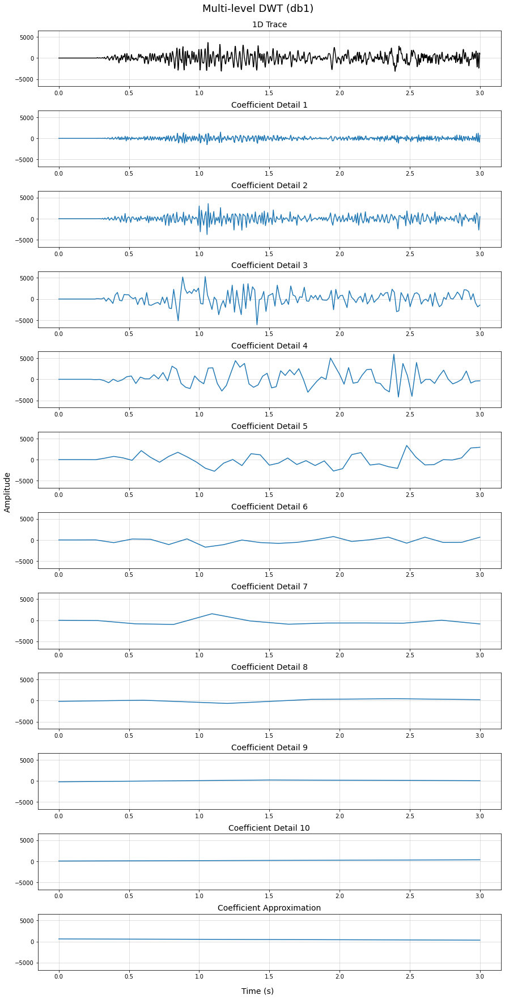

In [50]:
fig, axs = plt.subplots(nrows=12, figsize=(12,24), sharey=True, constrained_layout=True)
for i, ax in enumerate(fig.axes):
    if i == 0:
        ax.plot(time/1e3, signal, color='k')
        ax.set_title('1D Trace', size=14)
    elif i == 11:
        ax.plot(tlA_m, cA_m)
        ax.set_title('Coefficient Approximation', size=14)
    else:
        ax.plot(tlD_m[i-1], cD_m_lst[i-1])
        ax.set_title('%s' %'Coefficient Detail {}'.format(i), size=14)
    ax.grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Multi-level DWT (db1)', size=18)

##### Resample using linear spline interpolation

In [51]:
for i in range(len(c_m)):
    print(len(tl_m[i]), len(c_m[i]))

2 2
2 2
3 3
6 6
12 12
24 24
47 47
94 94
188 188
376 376
751 751


In [52]:
def int_c_m(t, coeff):
    int_c_m = interp1d(t, coeff, kind='linear')
    c_m_r = int_c_m(time/1e3)
    return c_m_r

In [53]:
c_m_r = [i for i in range(len(c_m))]

for i in range(len(c_m_r)):
    c_m_r[i] = int_c_m(tl_m[i], c_m[i])

    print([np.min(c_m[i]), np.min(c_m_r[i])], [np.max(c_m[i]), np.max(c_m_r[i])])

[333.28122, 333.2812194824219] [620.15625, 620.15625]
[46.406097, 46.406097412109375] [333.28122, 333.2812194824219]
[-212.79485, -212.7948455810547] [214.78366, 214.7836456298828]
[-674.99994, -674.9999542236329] [444.3751, 444.3750915527344]
[-986.4138, -986.318358968099] [1543.2603, 1536.4189965820303]
[-1715.6249, -1713.2398784179684] [804.3753, 801.1578039550777]
[-2760.368, -2752.646315755209] [3364.9443, 3343.179589843775]
[-4207.4995, -4048.19952148441] [5973.7495, 5688.674539062563]
[-6109.402, -6022.597439453188] [5313.907, 5120.7921225585715]
[-3757.4998, -3757.4998779296875] [3577.5, 3577.500244140625]
[-1495.5308, -1495.53076171875] [1495.5308, 1495.5307617186952]


In [54]:
cA_m_r = c_m_r[0]
rD_r = Reverse(c_m_r[1:])
cD_m_r_lst = [item for item in rD_r]

Text(0.5, 0.98, 'Resampled Multi-level DWT (db1)')

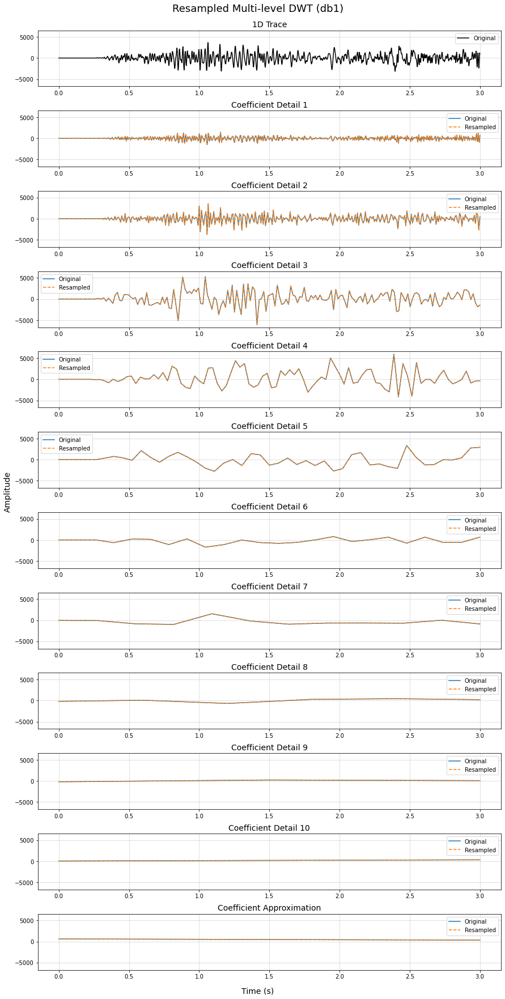

In [55]:
fig, axs = plt.subplots(nrows=12, figsize=(12,24), sharey=True, constrained_layout=True)
for i, ax in enumerate(fig.axes):
    if i == 0:
        ax.plot(time/1e3, signal, color='k')
        ax.set_title('1D Trace', size=14)
    elif i == 11:
        ax.plot(tlA_m, cA_m)
        ax.plot(time/1e3, cA_m_r, '--', color='tab:orange')
        ax.set_title('Coefficient Approximation', size=14)
    else:
        ax.plot(tlD_m[i-1], cD_m_lst[i-1])
        ax.plot(time/1e3, cD_m_r_lst[i-1], '--', color='tab:orange')
        ax.set_title('%s' %'Coefficient Detail {}'.format(i), size=14)
    ax.grid(alpha=0.5)
    ax.legend(['Original', 'Resampled'])
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Resampled Multi-level DWT (db1)', size=18)

### Scale to Frequency Conversion

Fps = Fc / scale

Feq = Fps / dt

where:

Fps - pseudo Frequency

Fc - central frequency of the wavelet

Feq - equivalent frequency or central frequency of the signal

dt - sample rate

In [56]:
dt = 0.002
scale = [2**n for n in np.linspace(1,max_level,max_level)]
Feq = pywt.scale2frequency(wavelet='db1', scale=scale, precision=24)/dt
Feq = np.round(Feq, 4)
Feq = np.append(Feq, 0)
Feq = Feq[::-1]
Feq

array([  0.    ,   0.4883,   0.9766,   1.9531,   3.9062,   7.8125,
        15.625 ,  31.25  ,  62.5   , 125.    , 250.    ])

In [57]:
dwt_coeffs = np.asarray(c_m_r)

Text(0.5, 0.98, 'DWT Scaleogram')

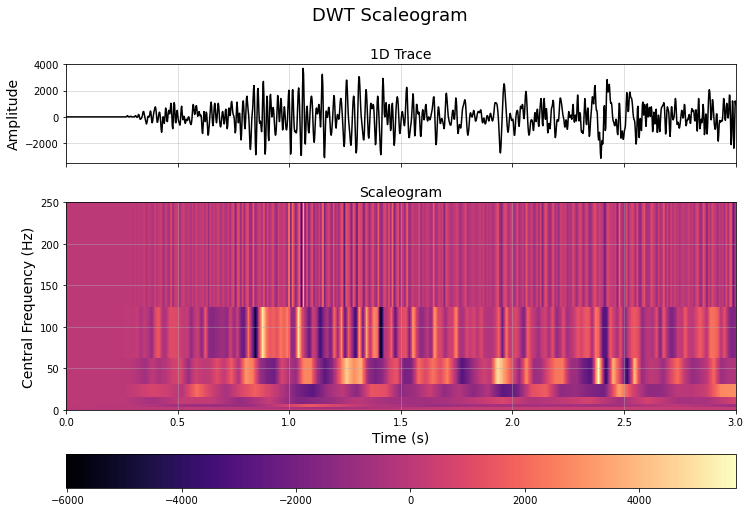

In [58]:
fig, axs = plt.subplots(figsize=(12,8), nrows=2, gridspec_kw={'height_ratios':[2,6]})
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_xlim(np.min(time/1e3), np.max(time/1e3))
axs[0].set_ylabel('Amplitude', size=14)
axs[0].set_title('1D Trace', size=14)
axs[0].set_xticklabels([])
axs[0].grid(alpha=0.5)

im = axs[1].pcolormesh(time/1e3, Feq, dwt_coeffs, shading='flat', cmap='magma')
axs[1].set_xlabel('Time (s)', size=14)
axs[1].set_ylabel('Central Frequency (Hz)', size=14)
axs[1].set_title('Scaleogram', size=14)
axs[1].grid(alpha=0.5)
fig.colorbar(im, ax=axs[1], orientation='horizontal')
plt.suptitle('DWT Scaleogram', size=18)

In [59]:
FEQ, T = np.meshgrid(Feq, time/1e3)

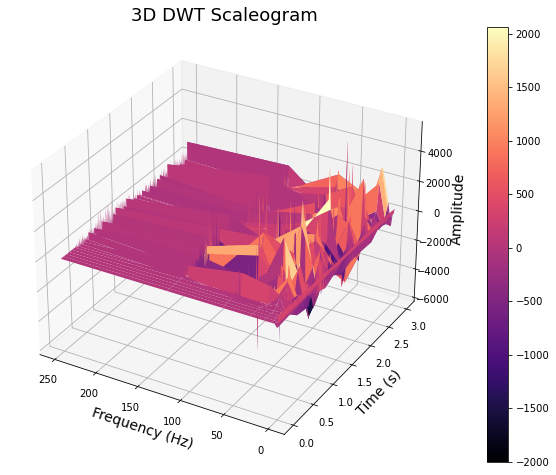

In [60]:
fig = plt.figure(figsize=(16,8)) 
ax = plt.axes(projection='3d')

surf = ax.plot_surface(FEQ, T, dwt_coeffs.T, cmap='magma')
ax.invert_xaxis()
ax.set_xlabel('Frequency (Hz)', size=14)
ax.set_ylabel('Time (s)', size=14)
ax.set_zlabel('Amplitude', size=14)
ax.set_title('3D DWT Scaleogram', size=18)
ax.grid(alpha=0.5)
ax.axis('tight')
fig.colorbar(surf, ax=ax, orientation='vertical')

### Coefficient Filtering

In [61]:
c_m_arr, c_m_slc  = pywt.coeffs_to_array(coeffs=c_m, padding=0)
c_m_arr.shape

(1505,)

In [62]:
c_m_slc

[(slice(None, 2, None),),
 {'d': (slice(2, 4, None),)},
 {'d': (slice(4, 7, None),)},
 {'d': (slice(7, 13, None),)},
 {'d': (slice(13, 25, None),)},
 {'d': (slice(25, 49, None),)},
 {'d': (slice(49, 96, None),)},
 {'d': (slice(96, 190, None),)},
 {'d': (slice(190, 378, None),)},
 {'d': (slice(378, 754, None),)},
 {'d': (slice(754, 1505, None),)}]

In [63]:
# Level 1 Coefficient Detail
c_m_arr[(slice(754, 1505, None),)] = np.zeros_like(c_m_arr[(slice(754, 1505, None),)])

In [64]:
c_m_n = pywt.array_to_coeffs(arr=c_m_arr, coeff_slices=c_m_slc, output_format='wavedec')

In [65]:
inv_signal_n = pywt.waverec(c_m_n, wavelet='db1', mode='zero')

In [66]:
signal.shape, inv_signal_n.shape

((1501,), (1502,))

In [67]:
inv_int_n = interp1d(np.linspace(0,3,1502), inv_signal_n, kind='nearest')
inv_signal_n = inv_int_n(time/1e3)
min(signal), min(inv_signal_n), max(signal), max(inv_signal_n)

(-3150.0, -3014.9998, 3690.0, 3149.9998)

In [68]:
signal.shape, inv_signal_n.shape

((1501,), (1501,))

Text(0.5, 0.98, 'Coefficient Filtered Single-level DWT (db1)')

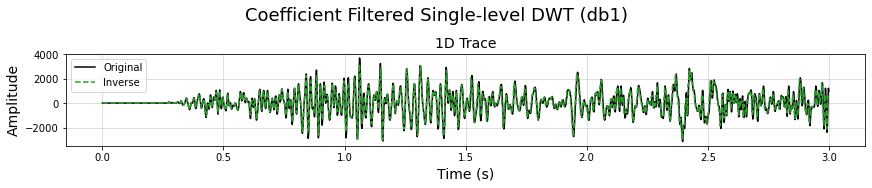

In [69]:
fig, ax = plt.subplots(figsize=(12,2.5), constrained_layout=True)
ax.plot(time/1e3, signal, color='k')
ax.plot(time/1e3, inv_signal_n, '--', color='tab:green')
ax.set_title('1D Trace', size=14)
ax.grid(alpha=0.5)
ax.legend(['Original', 'Inverse'])
ax.set_xlabel('Time (s)', size=14)
ax.set_ylabel('Amplitude', size=14)
plt.suptitle('Coefficient Filtered Single-level DWT (db1)', size=18)

### Single-level 2D DWT

In [70]:
coeff_len_2D_il = pywt.dwt_coeff_len(data_len=309, filter_len=2, mode='zero')
coeff_len_2D_xl = pywt.dwt_coeff_len(data_len=230, filter_len=2, mode='zero')
coeff_len_2D_il, coeff_len_2D_xl

(155, 115)

In [71]:
cA_2D, (cH_2D, cV_2D, cDg_2D) = pywt.dwt2(signal_2D, wavelet='db1', mode='zero')

In [72]:
il = np.linspace(2,310,155)
xl = np.linspace(1,230,115)

In [73]:
c_2D_lst = [cA_2D, cH_2D, cV_2D, cDg_2D]
c_name_2D = ['Approximation (LL)', 'Horizontal (LH)', 'Vertical (HL)', 'Diagonal (HH)']

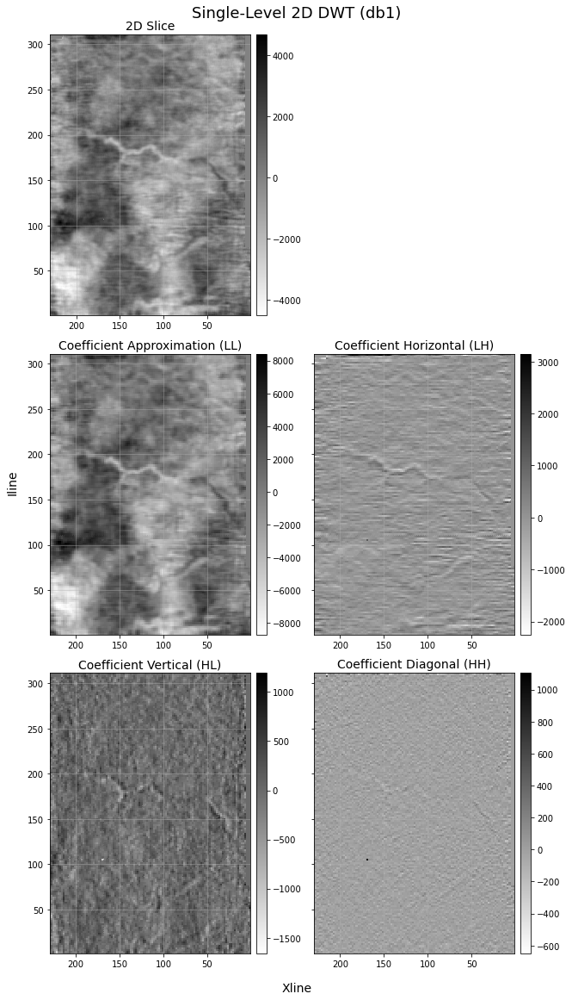

In [74]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xl, il, c_2D_lst[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(c_2D_lst[i-2]), vmax=np.max(c_2D_lst[i-2]))
        ax.set_title('%s' %'Coefficient ' + c_name_2D[i-2], size=14)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 2D DWT (db1)', size=18)
plt.tight_layout()

##### Resample using linear spline interpolation

In [75]:
from scipy.interpolate import interp2d

In [76]:
for i in range(len(c_2D_lst)):
    print(c_2D_lst[i].shape)

(155, 115)
(155, 115)
(155, 115)
(155, 115)


In [77]:
def int_2D(coeff):
    int_2D = interp2d(xl, il, coeff, kind='linear')
    c_2D_r = int_2D(xline_2D[0,:], iline_2D[:,0])
    return c_2D_r

In [78]:
c_2D_lst_r = ['cA_2D_n', 'cH_2D_n', 'cV_2D_n', 'cDg_2D_n']

for i in range(len(c_2D_lst_r)):
    c_2D_lst_r[i] = int_2D(c_2D_lst[i])

for i in range(len(c_2D_lst_r)):
    print([np.min(c_2D_lst[i]), np.min(c_2D_lst_r[i])], [np.max(c_2D_lst[i]), np.max(c_2D_lst_r[i])])

[-8707.5, -8689.028375750531] [8415.0, 8412.641895810588]
[-2249.9998, -2192.22685994644] [3150.0, 3142.434497816594]
[-1664.9999, -1664.9998779296875] [1192.5, 1192.5]
[-652.5, -652.5] [1102.5, 961.0152743476917]


In [79]:
for i in range(len(c_2D_lst_r)):
    print(c_2D_lst_r[i].shape)

(309, 230)
(309, 230)
(309, 230)
(309, 230)


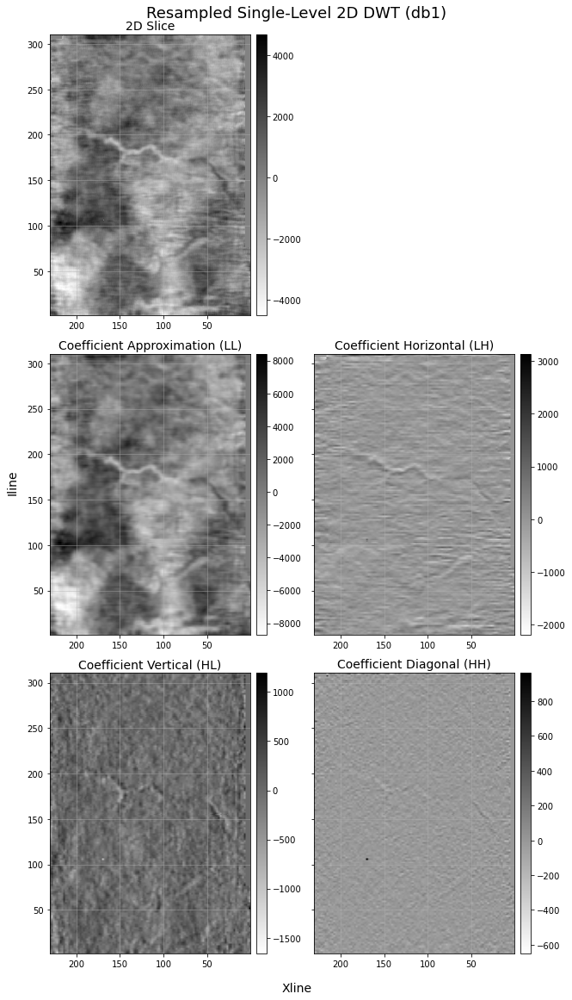

In [80]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, c_2D_lst_r[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(c_2D_lst_r[i-2]), vmax=np.max(c_2D_lst_r[i-2]))
        ax.set_title('%s' %'Coefficient ' + c_name_2D[i-2], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Resampled Single-Level 2D DWT (db1)', size=18)
plt.tight_layout()

### Inverse Single-level 2D DWT

In [81]:
inv_signal_2D = pywt.idwt2((cA_2D, (cH_2D, cV_2D, cDg_2D)), wavelet='db1', mode='zero')

In [82]:
signal_2D.shape, inv_signal_2D.shape

((309, 230), (310, 230))

In [83]:
inv_int_2D = interp2d(np.linspace(1,230,inv_signal_2D.shape[1]), np.linspace(2,310,inv_signal_2D.shape[0]), 
                      inv_signal_2D, kind='linear')
inv_signal_2D = inv_int_2D(xline_2D[0,:], iline_2D[:,0])
np.min(signal_2D), np.min(inv_signal_2D), np.max(signal_2D), np.max(inv_signal_2D)

(-4500.0, -4483.051948051948, 4680.0, 4516.071428571433)

In [84]:
signal_2D.shape, inv_signal_2D.shape

((309, 230), (309, 230))

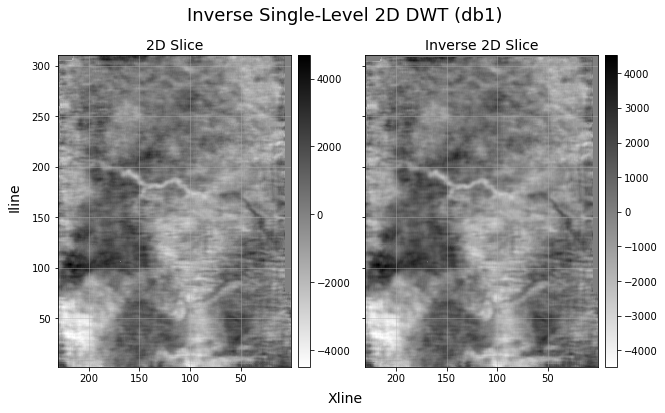

In [85]:
fig, axs = plt.subplots(ncols=2, figsize=(9,5.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, inv_signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(inv_signal_2D), vmax=np.max(inv_signal_2D))
        ax.set_title('Inverse 2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Inverse Single-Level 2D DWT (db1)', size=18)
plt.tight_layout()

### Multi-level 2D DWT

In [86]:
max_level_2D = pywt.dwtn_max_level(shape=(309, 230), wavelet='db1')
max_level_2D

7

In [87]:
c_m_2D = pywt.wavedec2(signal_2D, wavelet='db1', mode='zero', level=max_level_2D)

In [88]:
def Reverse(lst):
    lst.reverse()
    return lst

In [89]:
cA_m_2D = c_m_2D[0]
rD_2D = Reverse(c_m_2D[1:])
cD_m_2D_lst = [item for tpl in rD_2D for item in tpl]

In [90]:
il_m_2D = []
xl_m_2D = []

il_m_2D.append(np.linspace(2,310,c_m_2D[0].shape[0]))
xl_m_2D.append(np.linspace(1,230,c_m_2D[0].shape[1]))

for level in range(1, len(c_m_2D)):
    il_m_2D.append(np.linspace(2,310,c_m_2D[level][0].shape[0]))
    xl_m_2D.append(np.linspace(1,230,c_m_2D[level][0].shape[1]))

In [91]:
ilA_m_2D = il_m_2D[0]
xlA_m_2D = xl_m_2D[0]

nD = 3
ilD_m_2D_lst = [item for item in il_m_2D[1:] for i in range(nD)]
xlD_m_2D_lst = [item for item in xl_m_2D[1:] for i in range(nD)]
ilD_m_2D_lst = Reverse(ilD_m_2D_lst)
xlD_m_2D_lst = Reverse(xlD_m_2D_lst)

In [92]:
c_name_m_2D = ['Horizontal', 'Vertical', 'Diagonal']
c_name_m_2D = c_name_m_2D * max_level_2D
c_num_m_2D = [i for i in range(1, len(c_m_2D))]
c_num_m_2D = [num for num in c_num_m_2D for i in range(3)]

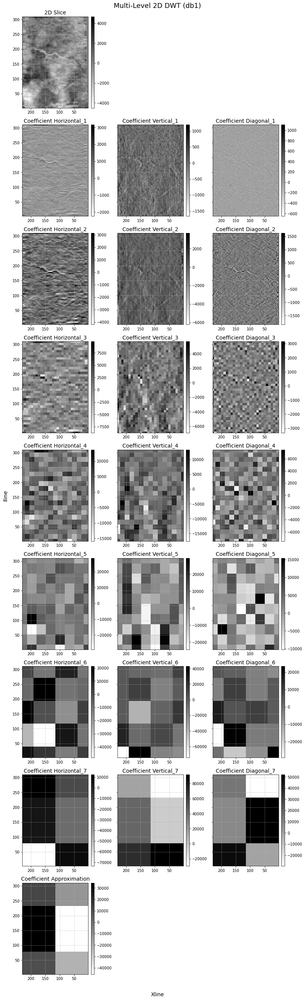

In [93]:
fig, axs = plt.subplots(nrows=9, ncols=3, figsize=(11,36), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 24:
        im[i] = ax.pcolormesh(xlA_m_2D, ilA_m_2D, cA_m_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(cA_m_2D), vmax=np.max(cA_m_2D))
        ax.set_title('Coefficient Approximation', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [1,2,25,26]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xlD_m_2D_lst[i-3], ilD_m_2D_lst[i-3], cD_m_2D_lst[i-3], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(cD_m_2D_lst[i-3]), vmax=np.max(cD_m_2D_lst[i-3]))
        ax.set_title('%s' %'Coefficient {}_{}'.format(c_name_m_2D[i-3], c_num_m_2D[i-3]), size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.set_xlim(1,230)
    ax.set_ylim(2,310)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Multi-Level 2D DWT (db1)', ha='center', va='center', size=18)
plt.tight_layout()

### Coefficient Filtering

In [94]:
c_m_2D_arr, c_m_2D_slc  = pywt.coeffs_to_array(coeffs=c_m_2D, padding=0)
c_m_2D_arr.shape

(313, 233)

In [95]:
c_m_2D_slc

[(slice(None, 3, None), slice(None, 2, None)),
 {'ad': (slice(None, 3, None), slice(2, 4, None)),
  'da': (slice(3, 6, None), slice(None, 2, None)),
  'dd': (slice(3, 6, None), slice(2, 4, None))},
 {'ad': (slice(None, 5, None), slice(4, 8, None)),
  'da': (slice(6, 11, None), slice(None, 4, None)),
  'dd': (slice(6, 11, None), slice(4, 8, None))},
 {'ad': (slice(None, 10, None), slice(8, 16, None)),
  'da': (slice(11, 21, None), slice(None, 8, None)),
  'dd': (slice(11, 21, None), slice(8, 16, None))},
 {'ad': (slice(None, 20, None), slice(16, 31, None)),
  'da': (slice(21, 41, None), slice(None, 15, None)),
  'dd': (slice(21, 41, None), slice(16, 31, None))},
 {'ad': (slice(None, 39, None), slice(31, 60, None)),
  'da': (slice(41, 80, None), slice(None, 29, None)),
  'dd': (slice(41, 80, None), slice(31, 60, None))},
 {'ad': (slice(None, 78, None), slice(60, 118, None)),
  'da': (slice(80, 158, None), slice(None, 58, None)),
  'dd': (slice(80, 158, None), slice(60, 118, None))},
 {'a

In [96]:
# Level 1 Coefficient Vertical
c_m_2D_arr[(slice(158, 313, None), slice(None, 115, None))] = np.zeros_like(c_m_2D_arr[(slice(158, 313, None), 
                                                                                        slice(None, 115, None))])
# Level 1 Coefficient Diagonal
c_m_2D_arr[(slice(158, 313, None), slice(118, 233, None))] = np.zeros_like(c_m_2D_arr[(slice(158, 313, None), 
                                                                                       slice(118, 233, None))])
# Level 2 Coefficient Diagonal
c_m_2D_arr[(slice(80, 158, None), slice(60, 118, None))] = np.zeros_like(c_m_2D_arr[(slice(80, 158, None), 
                                                                                     slice(60, 118, None))])

In [97]:
c_m_2D_n = pywt.array_to_coeffs(arr=c_m_2D_arr, coeff_slices=c_m_2D_slc, output_format='wavedec2')

In [98]:
inv_signal_2D_n = pywt.waverec2(c_m_2D_n, wavelet='db1', mode='zero')

In [99]:
signal_2D.shape, inv_signal_2D_n.shape

((309, 230), (310, 230))

In [100]:
inv_int_2D_n = interp2d(np.linspace(1,230,230), np.linspace(2,310,310), inv_signal_2D_n, kind='linear')
inv_signal_2D_n = inv_int_2D_n(xline_2D[0,:], iline_2D[:,0])
np.min(signal_2D), np.min(inv_signal_2D_n), np.max(signal_2D), np.max(inv_signal_2D_n)

(-4500.0, -4443.748535156251, 4680.0, 4424.06103515625)

In [101]:
signal_2D.shape, inv_signal_2D_n.shape

((309, 230), (309, 230))

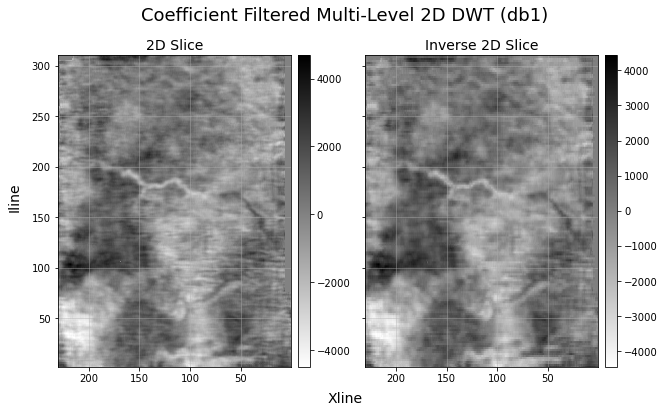

In [102]:
fig, axs = plt.subplots(ncols=2, figsize=(9,5.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, inv_signal_2D_n, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(inv_signal_2D_n), vmax=np.max(inv_signal_2D_n))
        ax.set_title('Inverse 2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Coefficient Filtered Multi-Level 2D DWT (db1)', size=18)
plt.tight_layout()

### Single-level 3D DWT

In [103]:
coeff_len_3D_il = pywt.dwt_coeff_len(data_len=309, filter_len=2, mode='zero')
coeff_len_3D_xl = pywt.dwt_coeff_len(data_len=230, filter_len=2, mode='zero')
coeff_len_3D_tl = pywt.dwt_coeff_len(data_len=1501, filter_len=2, mode='zero')
coeff_len_3D_il, coeff_len_3D_xl, coeff_len_3D_tl

(155, 115, 751)

In [104]:
c_3D = pywt.dwtn(signal_3D, wavelet='db1', mode='zero')

In [105]:
c_3D_klst = list(c_3D.keys())
c_3D_vlst = list(c_3D.values())

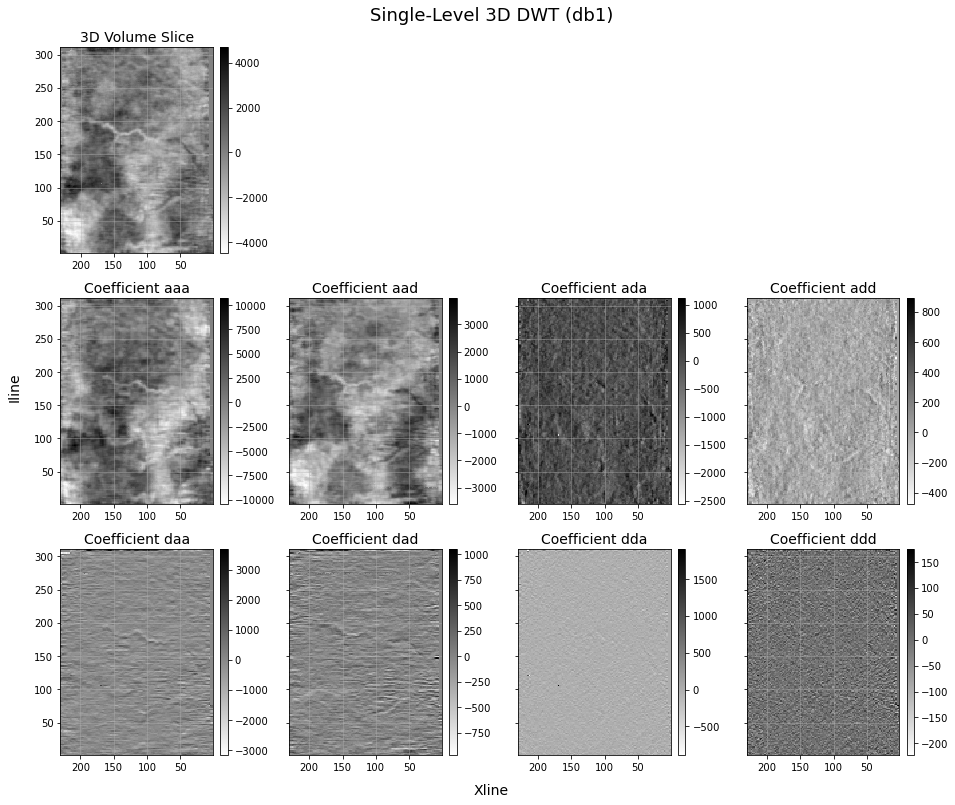

In [106]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_3D[:,:,421]), vmax=np.max(signal_3D[:,:,421]))
        ax.set_title('3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [1,2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xl, il, c_3D_vlst[i-4][:,:,211], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(c_3D_vlst[i-4][:,:,211]), vmax=np.max(c_3D_vlst[i-4][:,:,211]))
        ax.set_title('%s' %'Coefficient ' + c_3D_klst[i-4], size=14)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 3D DWT (db1)', size=18)
plt.tight_layout()

##### Resample using image zoom

In [107]:
from scipy import ndimage

In [108]:
for i in range(len(c_3D_vlst)):
    print(c_3D_vlst[i].shape)

(155, 115, 751)
(155, 115, 751)
(155, 115, 751)
(155, 115, 751)
(155, 115, 751)
(155, 115, 751)
(155, 115, 751)
(155, 115, 751)


In [109]:
c_3D_vlst_r = ['aaa_n', 'aad_n', 'ada_n', 'add_n', 'daa_n', 'dad_n', 'dda_n', 'ddd_n']

for i in range(len(c_3D_vlst)):
    c_3D_vlst_r[i] = ndimage.zoom(c_3D_vlst[i], [signal_3D.shape[0]/c_3D_vlst[i].shape[0], 
                                                 signal_3D.shape[1]/c_3D_vlst[i].shape[1], 
                                                 signal_3D.shape[2]/c_3D_vlst[i].shape[2]])

In [110]:
for i in range(len(c_3D_vlst_r)):
    print(c_3D_vlst_r[i].shape)

(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)
(309, 230, 1501)


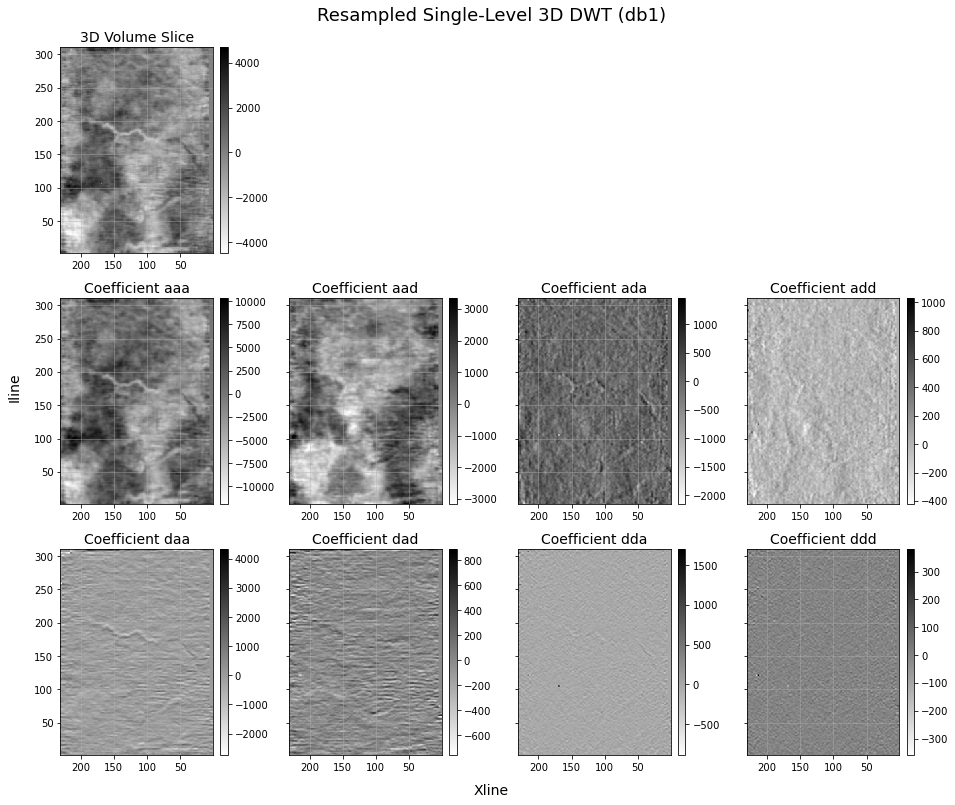

In [111]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_3D[:,:,421]), vmax=np.max(signal_3D[:,:,421]))
        ax.set_title('3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [1,2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], c_3D_vlst_r[i-4][:,:,421], shading='auto', 
                              cmap=plt.cm.gray_r, 
                              vmin=np.min(c_3D_vlst_r[i-4][:,:,421]), vmax=np.max(c_3D_vlst_r[i-4][:,:,421]))
        ax.set_title('%s' %'Coefficient ' + c_3D_klst[i-4], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Resampled Single-Level 3D DWT (db1)', size=18)
plt.tight_layout()

### Inverse Single-level 3D DWT

In [112]:
inv_signal_3D = pywt.idwtn(c_3D, wavelet='db1', mode='zero')

In [113]:
signal_3D.shape, inv_signal_3D.shape

((309, 230, 1501), (310, 230, 1502))

In [114]:
inv_signal_3D = ndimage.zoom(inv_signal_3D, [signal_3D.shape[0]/inv_signal_3D.shape[0], 
                                                 signal_3D.shape[1]/inv_signal_3D.shape[1], 
                                                 signal_3D.shape[2]/inv_signal_3D.shape[2]])
np.min(signal_3D), np.min(inv_signal_3D), np.max(signal_3D), np.max(inv_signal_3D)

(-5715.0, -6060.784, 5715.0, 6104.0444)

In [115]:
signal_3D.shape, inv_signal_3D.shape

((309, 230, 1501), (309, 230, 1501))

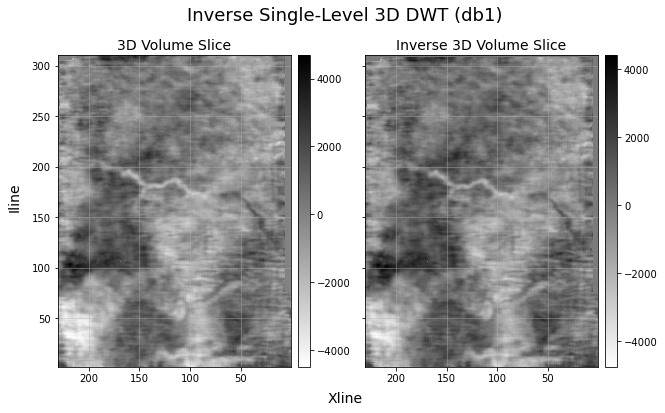

In [116]:
fig, axs = plt.subplots(ncols=2, figsize=(9,5.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_3D[:,:,421]), vmax=np.max(signal_3D[:,:,421]))
        ax.set_title('3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], inv_signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(inv_signal_3D[:,:,421]), vmax=np.max(inv_signal_3D[:,:,421]))
        ax.set_title('Inverse 3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Inverse Single-Level 3D DWT (db1)', size=18)
plt.tight_layout()

### Multi-level 3D DWT

In [117]:
max_level_3D = pywt.dwtn_max_level(shape=(309,230,1501), wavelet='db1')
max_level_3D

7

In [118]:
c_m_3D = pywt.wavedecn(signal_3D, wavelet='db1', mode='zero', level=max_level_3D)

In [119]:
def Reverse(lst):
    lst.reverse()
    return lst

In [120]:
cA_m_3D = c_m_3D[0]
rD_3D = Reverse(c_m_3D[1:])

cD_m_3D_klst_lst = []
cD_m_3D_vlst_lst = []

for i in range(len(rD_3D)):
    cD_m_3D_klst_lst.append(list(rD_3D[i].keys()))
    cD_m_3D_vlst_lst.append(list(rD_3D[i].values()))
    
cD_m_3D_klst = [item for lst in cD_m_3D_klst_lst for item in lst]
cD_m_3D_vlst = [item for lst in cD_m_3D_vlst_lst for item in lst]

In [121]:
il_m_3D = []
xl_m_3D = []
twt_m_3D = []

il_m_3D.append(np.linspace(2, 310, c_m_3D[0].shape[0]))
xl_m_3D.append(np.linspace(1, 230, c_m_3D[0].shape[1]))
twt_m_3D.append(np.linspace(0, 3, c_m_3D[0].shape[2]))

for level in range(len(cD_m_3D_vlst_lst)):
    il_m_3D.append(np.linspace(2, 310, cD_m_3D_vlst_lst[level][0].shape[0]))
    xl_m_3D.append(np.linspace(1, 230, cD_m_3D_vlst_lst[level][0].shape[1]))
    twt_m_3D.append(np.linspace(0, 3, cD_m_3D_vlst_lst[level][0].shape[2]))

In [122]:
ilA_m_3D = il_m_3D[0]
xlA_m_3D = xl_m_3D[0]
twtA_m_3D = twt_m_3D[0]

ilD_m_3D_lst = [item for item in il_m_3D[1:] for i in range(7)]
xlD_m_3D_lst = [item for item in xl_m_3D[1:] for i in range(7)]
twtD_m_3D_lst = [item for item in twt_m_3D[1:] for i in range(7)]

In [123]:
c_num_m_3D = [i for i in range(1,8)]
c_num_m_3D = [num for num in c_num_m_3D for i in range(7)]

In [124]:
np.ceil(cA_m_3D.shape[2]/2), cA_m_3D.shape

(6.0, (3, 2, 12))

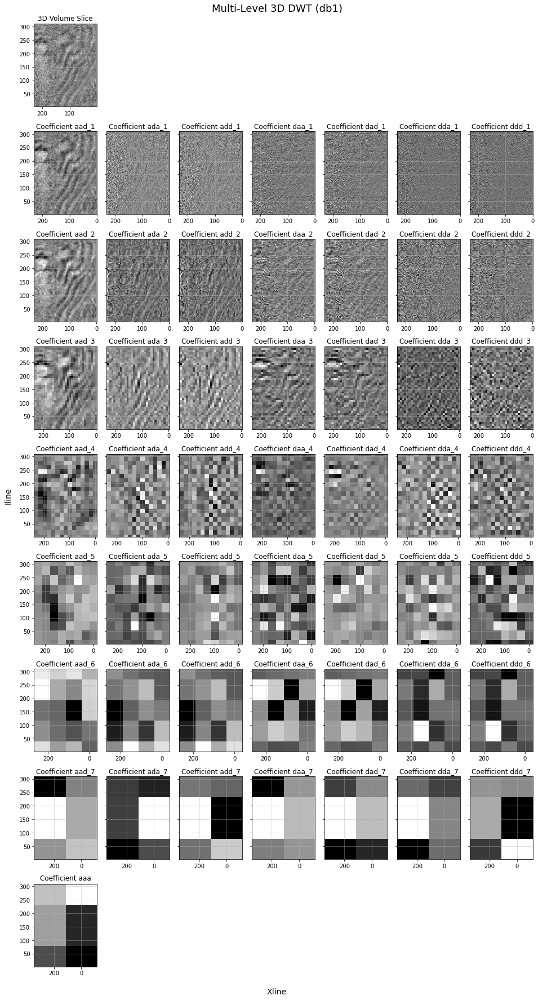

In [125]:
fig, axs = plt.subplots(nrows=9, ncols=7, figsize=(13,24), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,-1], iline_3D[:,:,-1], signal_3D[:,:,-1], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_3D[:,:,-1]), vmax=np.max(signal_3D[:,:,-1]))
        ax.set_title('3D Volume Slice', size=12)
    elif i == 56:
        im[i] = ax.pcolormesh(xlA_m_3D, ilA_m_3D, cA_m_3D[:,:,-1], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(cA_m_3D[:,:,-1]), vmax=np.max(cA_m_3D[:,:,-1]))
        ax.set_title('Coefficient aaa', size=12)
    elif i in np.linspace(1,6,6) or i in np.linspace(57,62,6):
        ax.set_axis_off()        
    else:
        im[i] = ax.pcolormesh(xlD_m_3D_lst[i-7], ilD_m_3D_lst[i-7], cD_m_3D_vlst[i-7][:,:,-1], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(cD_m_3D_vlst[i-7][:,:,-1]), vmax=np.max(cD_m_3D_vlst[i-7][:,:,-1]))
        ax.set_title('%s' %'Coefficient {}_{}'.format(cD_m_3D_klst[i-7], c_num_m_3D[i-7]), size=12)
    ax.set_ylim(2,310)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Multi-Level 3D DWT (db1)', ha='center', va='center', size=18)
plt.tight_layout()

### Coefficient Filtering

In [126]:
c_m_3D_arr, c_m_3D_slc  = pywt.coeffs_to_array(coeffs=c_m_3D, padding=0)
c_m_3D_arr.shape

(313, 233, 1504)

In [127]:
c_m_3D_slc

[(slice(None, 3, None), slice(None, 2, None), slice(None, 12, None)),
 {'aad': (slice(None, 3, None), slice(None, 2, None), slice(12, 24, None)),
  'ada': (slice(None, 3, None), slice(2, 4, None), slice(None, 12, None)),
  'add': (slice(None, 3, None), slice(2, 4, None), slice(12, 24, None)),
  'daa': (slice(3, 6, None), slice(None, 2, None), slice(None, 12, None)),
  'dad': (slice(3, 6, None), slice(None, 2, None), slice(12, 24, None)),
  'dda': (slice(3, 6, None), slice(2, 4, None), slice(None, 12, None)),
  'ddd': (slice(3, 6, None), slice(2, 4, None), slice(12, 24, None))},
 {'aad': (slice(None, 5, None), slice(None, 4, None), slice(24, 48, None)),
  'ada': (slice(None, 5, None), slice(4, 8, None), slice(None, 24, None)),
  'add': (slice(None, 5, None), slice(4, 8, None), slice(24, 48, None)),
  'daa': (slice(6, 11, None), slice(None, 4, None), slice(None, 24, None)),
  'dad': (slice(6, 11, None), slice(None, 4, None), slice(24, 48, None)),
  'dda': (slice(6, 11, None), slice(4, 8,

In [128]:
# Level 1 Coefficient ada
c_m_3D_arr[(slice(None, 155, None), slice(118, 233, None), slice(None, 751, None))] = np.zeros_like(c_m_3D_arr[
    (slice(None, 155, None), slice(118, 233, None), slice(None, 751, None))])
# Level 1 Coefficient add
c_m_3D_arr[(slice(None, 155, None), slice(118, 233, None), slice(753, 1504, None))] = np.zeros_like(c_m_3D_arr[
    (slice(None, 155, None), slice(118, 233, None), slice(753, 1504, None))])
# Level 1 Coefficient daa
c_m_3D_arr[(slice(158, 313, None), slice(None, 115, None), slice(None, 751, None))] = np.zeros_like(c_m_3D_arr[
    (slice(158, 313, None), slice(None, 115, None), slice(None, 751, None))])
# Level 1 Coefficient dad
c_m_3D_arr[(slice(158, 313, None), slice(None, 115, None), slice(753, 1504, None))] = np.zeros_like(c_m_3D_arr[
    (slice(158, 313, None), slice(None, 115, None), slice(753, 1504, None))])
# Level 1 Coefficient dda
c_m_3D_arr[(slice(158, 313, None), slice(118, 233, None), slice(None, 751, None))] = np.zeros_like(c_m_3D_arr[
    (slice(158, 313, None), slice(118, 233, None), slice(None, 751, None))])
# Level 1 Coefficient ddd
c_m_3D_arr[(slice(158, 313, None), slice(118, 233, None), slice(753, 1504, None))] = np.zeros_like(c_m_3D_arr[
    (slice(158, 313, None), slice(118, 233, None), slice(753, 1504, None))])
# Level 2 Coefficient dda
c_m_3D_arr[(slice(80, 158, None), slice(60, 118, None), slice(None, 376, None))] = np.zeros_like(c_m_3D_arr[
    (slice(80, 158, None), slice(60, 118, None), slice(None, 376, None))])
# Level 2 Coefficient ddd
c_m_3D_arr[(slice(80, 158, None), slice(60, 118, None), slice(377, 753, None))] = np.zeros_like(c_m_3D_arr[
    (slice(80, 158, None), slice(60, 118, None), slice(377, 753, None))])

In [129]:
c_m_3D_n = pywt.array_to_coeffs(arr=c_m_3D_arr, coeff_slices=c_m_3D_slc, output_format='wavedecn')

In [130]:
inv_signal_3D_n = pywt.waverecn(c_m_3D_n, wavelet='db1', mode='zero')

In [131]:
signal_3D.shape, inv_signal_3D_n.shape

((309, 230, 1501), (310, 230, 1502))

In [132]:
inv_signal_3D_n = ndimage.zoom(inv_signal_3D_n, [signal_3D.shape[0]/inv_signal_3D_n.shape[0], 
                                                 signal_3D.shape[1]/inv_signal_3D_n.shape[1], 
                                                 signal_3D.shape[2]/inv_signal_3D_n.shape[2]])
np.min(signal_3D), np.min(inv_signal_3D_n), np.max(signal_3D), np.max(inv_signal_3D_n)

(-5715.0, -6483.3047, 5715.0, 6321.076)

In [133]:
signal_3D.shape, inv_signal_3D_n.shape

((309, 230, 1501), (309, 230, 1501))

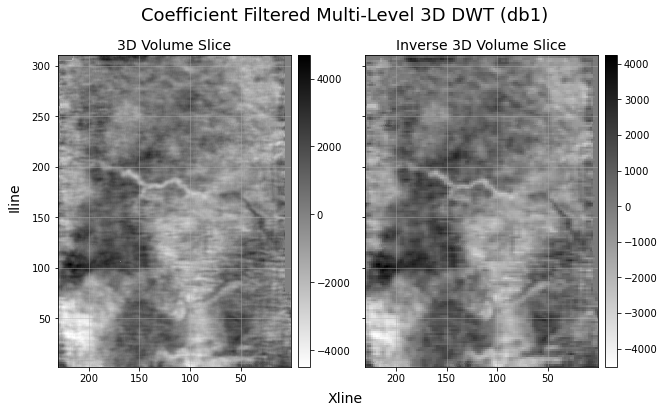

In [134]:
fig, axs = plt.subplots(ncols=2, figsize=(9,5.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', 
                              cmap=plt.cm.gray_r, vmin=np.min(signal_3D[:,:,421]), vmax=np.max(signal_3D[:,:,421]))
        ax.set_title('3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], inv_signal_3D_n[:,:,421], shading='auto', 
                              cmap=plt.cm.gray_r, vmin=np.min(inv_signal_3D_n[:,:,421]), vmax=np.max(inv_signal_3D_n[:,:,421]))
        ax.set_title('Inverse 3D Volume Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Coefficient Filtered Multi-Level 3D DWT (db1)', size=18)
plt.tight_layout()

### Alternative Wavelets

In [135]:
print(pywt.families(short=True))

['haar', 'db', 'sym', 'coif', 'bior', 'rbio', 'dmey', 'gaus', 'mexh', 'morl', 'cgau', 'shan', 'fbsp', 'cmor']


#### Haar Wavelets

In [136]:
haar_waveletlist = pywt.wavelist(family='haar')
print(haar_waveletlist)

['haar']


In [137]:
haar_wavelet = pywt.Wavelet('haar')
print(haar_wavelet)

Wavelet haar
  Family name:    Haar
  Short name:     haar
  Filters length: 2
  Orthogonal:     True
  Biorthogonal:   True
  Symmetry:       asymmetric
  DWT:            True
  CWT:            False


##### Single-level 1D DWT (haar)

In [138]:
haar_cA, haar_cD = pywt.dwt(signal, wavelet='haar', mode='zero')

Text(0.5, 0.98, 'Single-level DWT (haar)')

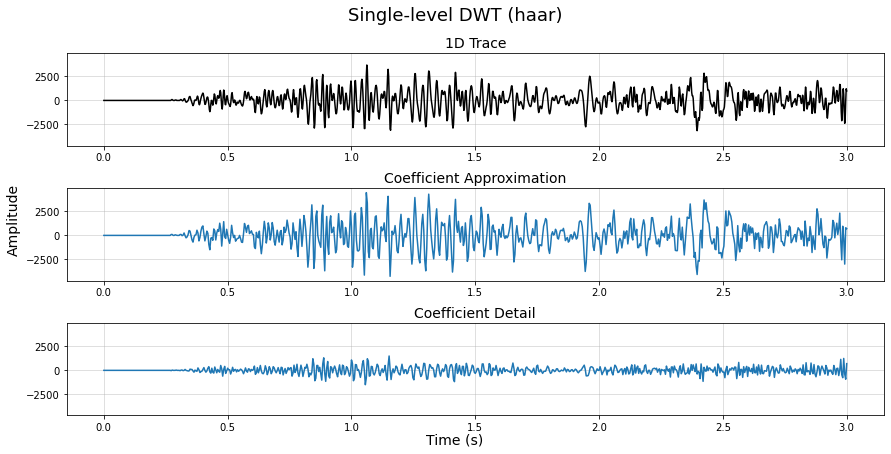

In [139]:
fig, axs = plt.subplots(figsize=(12,6), nrows=3, sharey=True, constrained_layout=True)
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_title('1D Trace', size=14)
axs[0].grid(alpha=0.5)
axs[1].plot(tl, haar_cA)
axs[1].set_title('Coefficient Approximation', size=14)
axs[1].grid(alpha=0.5)
axs[2].plot(tl, haar_cD)
axs[2].set_title('Coefficient Detail', size=14)
axs[2].grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-level DWT (haar)', size=18)

##### Single-level 2D DWT (haar)

In [140]:
haar_cA_2D, (haar_cH_2D, haar_cV_2D, haar_cDg_2D) = pywt.dwt2(signal_2D, wavelet='haar', mode='zero')

In [141]:
haar_c_2D_lst = [haar_cA_2D, haar_cH_2D, haar_cV_2D, haar_cDg_2D]

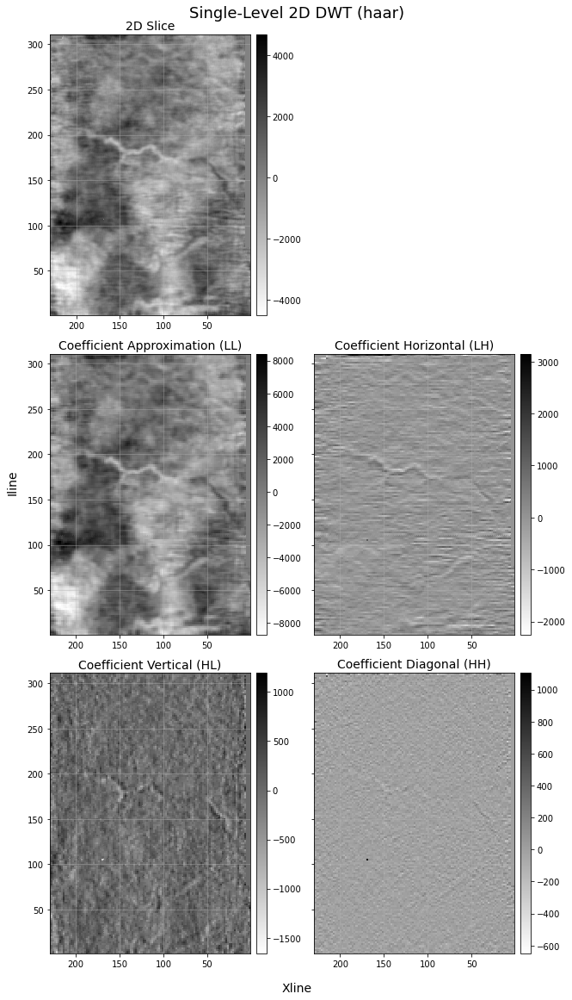

In [142]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xl, il, haar_c_2D_lst[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(haar_c_2D_lst[i-2]), vmax=np.max(haar_c_2D_lst[i-2]))
        ax.set_title('%s' %'Coefficient ' + c_name_2D[i-2], size=14)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 2D DWT (haar)', size=18)
plt.tight_layout()

#### Biorthogonal Wavelets

In [143]:
bior_waveletlist = pywt.wavelist(family='bior')
print(bior_waveletlist)

['bior1.1', 'bior1.3', 'bior1.5', 'bior2.2', 'bior2.4', 'bior2.6', 'bior2.8', 'bior3.1', 'bior3.3', 'bior3.5', 'bior3.7', 'bior3.9', 'bior4.4', 'bior5.5', 'bior6.8']


In [144]:
bior11_wavelet = pywt.Wavelet('bior1.1')
print(bior11_wavelet)

Wavelet bior1.1
  Family name:    Biorthogonal
  Short name:     bior
  Filters length: 2
  Orthogonal:     False
  Biorthogonal:   True
  Symmetry:       symmetric
  DWT:            True
  CWT:            False


##### Single-level 1D DWT (bior1.1)

In [145]:
bior11_cA, bior11_cD = pywt.dwt(signal, wavelet='bior1.1', mode='zero')

Text(0.5, 0.98, 'Single-level DWT (bior1.1)')

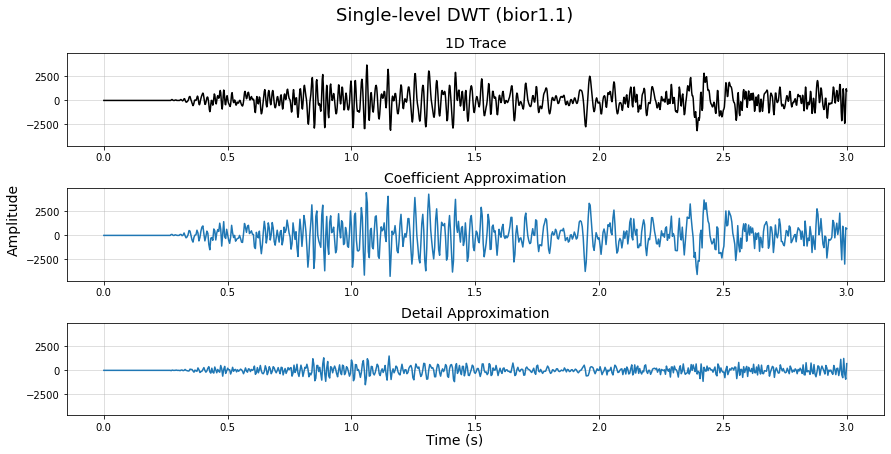

In [146]:
fig, axs = plt.subplots(figsize=(12,6), nrows=3, sharey=True, constrained_layout=True)
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_title('1D Trace', size=14)
axs[0].grid(alpha=0.5)
axs[1].plot(tl, bior11_cA)
axs[1].set_title('Coefficient Approximation', size=14)
axs[1].grid(alpha=0.5)
axs[2].plot(tl, bior11_cD)
axs[2].set_title('Detail Approximation', size=14)
axs[2].grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-level DWT (bior1.1)', size=18)

##### Single-level 2D DWT (bior1.1)

In [147]:
bior11_cA_2D, (bior11_cH_2D, bior11_cV_2D, bior11_cDg_2D) = pywt.dwt2(signal_2D, wavelet='bior1.1', mode='zero')

In [148]:
bior11_c_2D_lst = [bior11_cA_2D, bior11_cH_2D, bior11_cV_2D, bior11_cDg_2D]

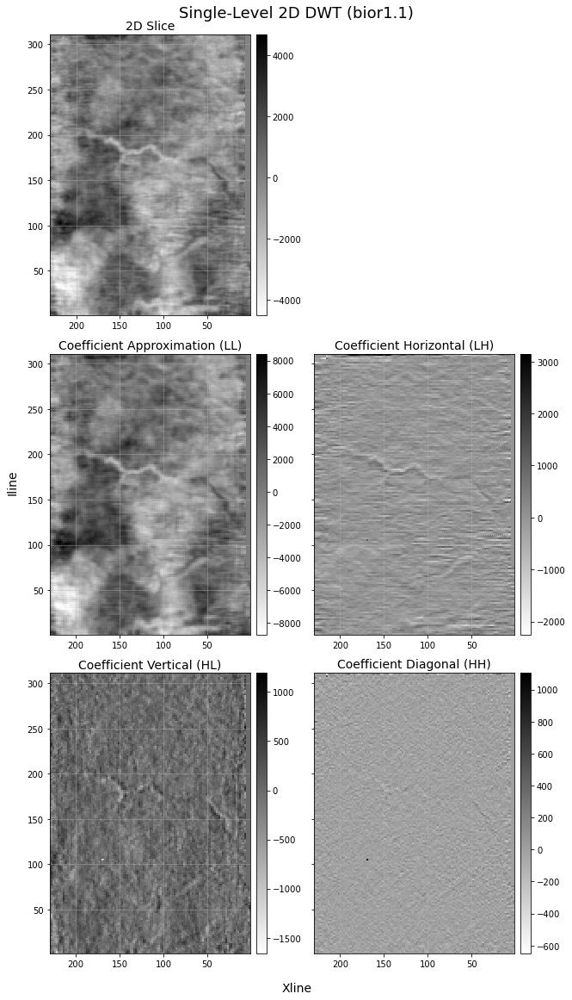

In [149]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xl, il, bior11_c_2D_lst[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(bior11_c_2D_lst[i-2]), vmax=np.max(bior11_c_2D_lst[i-2]))
        ax.set_title('%s' %'Coefficient ' + c_name_2D[i-2], size=14)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 2D DWT (bior1.1)', size=18)
plt.tight_layout()

#### Reverse Biorthogonal Wavelets

In [150]:
rbio_waveletlist = pywt.wavelist(family='rbio')
print(rbio_waveletlist)

['rbio1.1', 'rbio1.3', 'rbio1.5', 'rbio2.2', 'rbio2.4', 'rbio2.6', 'rbio2.8', 'rbio3.1', 'rbio3.3', 'rbio3.5', 'rbio3.7', 'rbio3.9', 'rbio4.4', 'rbio5.5', 'rbio6.8']


In [151]:
rbio11_wavelet = pywt.Wavelet('rbio1.1')
print(rbio11_wavelet)

Wavelet rbio1.1
  Family name:    Reverse biorthogonal
  Short name:     rbio
  Filters length: 2
  Orthogonal:     False
  Biorthogonal:   True
  Symmetry:       symmetric
  DWT:            True
  CWT:            False


##### Single-level 1D DWT (rbio1.1)

In [152]:
rbio11_cA, rbio11_cD = pywt.dwt(signal, wavelet='rbio1.1', mode='zero')

Text(0.5, 0.98, 'Single-level DWT (rbio1.1)')

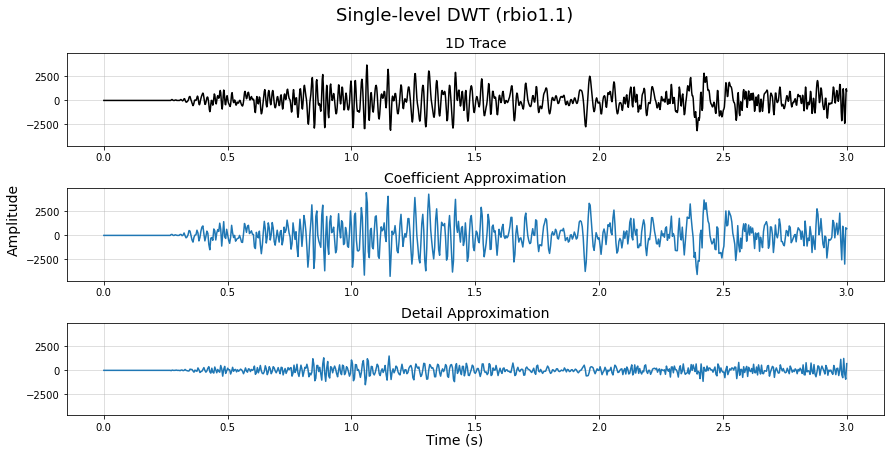

In [153]:
fig, axs = plt.subplots(figsize=(12,6), nrows=3, sharey=True, constrained_layout=True)
axs[0].plot(time/1e3, signal, color='k')
axs[0].set_title('1D Trace', size=14)
axs[0].grid(alpha=0.5)
axs[1].plot(tl, rbio11_cA)
axs[1].set_title('Coefficient Approximation', size=14)
axs[1].grid(alpha=0.5)
axs[2].plot(tl, rbio11_cD)
axs[2].set_title('Detail Approximation', size=14)
axs[2].grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-level DWT (rbio1.1)', size=18)

##### Single-level 2D DWT (rbio1.1)

In [154]:
rbio11_cA_2D, (rbio11_cH_2D, rbio11_cV_2D, rbio11_cDg_2D) = pywt.dwt2(signal_2D, wavelet='rbio1.1', mode='zero')

In [155]:
rbio11_c_2D_lst = [rbio11_cA_2D, rbio11_cH_2D, rbio11_cV_2D, rbio11_cDg_2D]

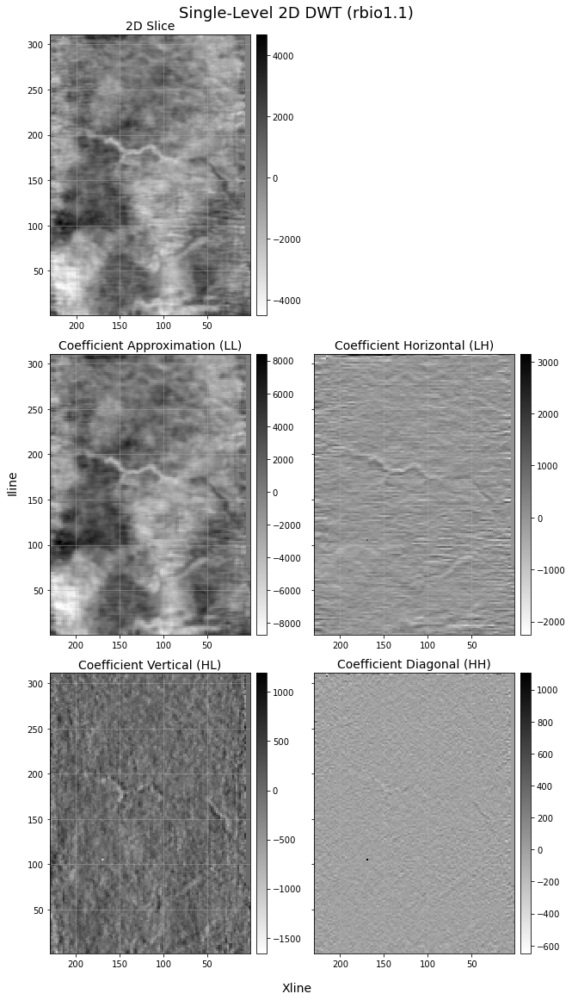

In [156]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xl, il, rbio11_c_2D_lst[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(rbio11_c_2D_lst[i-2]), vmax=np.max(rbio11_c_2D_lst[i-2]))
        ax.set_title('%s' %'Coefficient ' + c_name_2D[i-2], size=14)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 2D DWT (rbio1.1)', size=18)
plt.tight_layout()

##### Compare wavelets

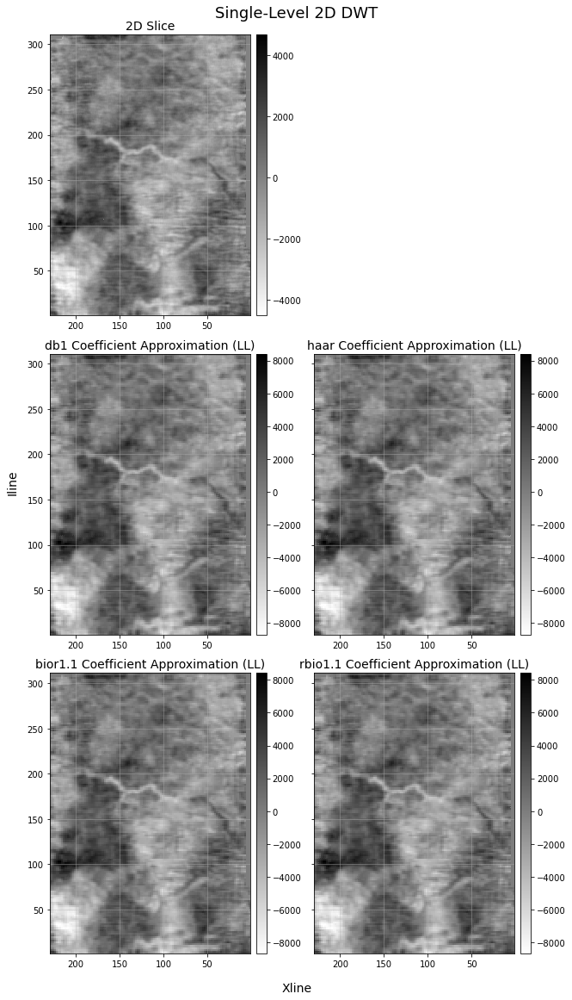

In [157]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(9,16), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(signal_2D), vmax=np.max(signal_2D))
        ax.set_title('2D Slice', size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        ax.set_axis_off()
    elif i == 2:
        im[i] = ax.pcolormesh(xl, il, c_2D_lst[i-2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(c_2D_lst[i-2]), vmax=np.max(c_2D_lst[i-2]))
        ax.set_title('%s' %'db1 Coefficient ' + c_name_2D[i-2], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 3:
        im[i] = ax.pcolormesh(xl, il, haar_c_2D_lst[i-3], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(haar_c_2D_lst[i-3]), vmax=np.max(haar_c_2D_lst[i-3]))
        ax.set_title('%s' %'haar Coefficient ' + c_name_2D[i-3], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 4:
        im[i] = ax.pcolormesh(xl, il, bior11_c_2D_lst[i-4], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(bior11_c_2D_lst[i-4]), vmax=np.max(bior11_c_2D_lst[i-4]))
        ax.set_title('%s' %'bior1.1 Coefficient ' + c_name_2D[i-4], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        im[i] = ax.pcolormesh(xl, il, rbio11_c_2D_lst[i-5], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.min(rbio11_c_2D_lst[i-5]), vmax=np.max(rbio11_c_2D_lst[i-5]))
        ax.set_title('%s' %'rbio1.1 Coefficient ' + c_name_2D[i-5], size=14)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.set_xlim(1,230)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level 2D DWT', size=18)
plt.tight_layout()

## Feature Generation

Principal Components

Rolling Statistics

Derivative Filters

In [158]:
import scipy.ndimage
import skimage.filters
import skimage.feature
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

### Single Level 1D Statistical Features

We'll make use of the Single-Level Coefficient Approximation and Coefficient Detail

In [159]:
features = c_lst_r

In [160]:
statistical_features_names = ['Mean', 'Median', 'Standard_Deviation', 'Variance', 
                              '1st_Discrete_Diffference_2D', '2nd_Discrete_Diffference_2D']

Method: Coefficient > Resample > Rolling Statistics

In [161]:
mean = []
median = []
std = []
var = []
diff_1st_2D = []
diff_2nd_2D = []

def stat_feat(coeffs):
    
    for coeff in range(len(coeffs)):
        mean.append(scipy.ndimage.generic_filter(features[coeff], np.nanmean, size=3, mode='constant'))
        median.append(scipy.ndimage.generic_filter(features[coeff], np.nanmedian, size=3, mode='constant'))
        std.append(scipy.ndimage.generic_filter(features[coeff], np.nanstd, size=3, mode='constant'))
        var.append(scipy.ndimage.generic_filter(features[coeff], np.nanvar, size=3, mode='constant'))
        diff_1st_2D.append(np.diff(features[coeff], n=1, append=0))
        diff_2nd_2D.append(np.diff(features[coeff], n=2, prepend=0, append=0))
        
    return [mean, median, std, var, diff_1st_2D, diff_2nd_2D]

In [162]:
statistical_features = stat_feat(features)

Text(0.5, 0.98, 'Single-Level DWT Coefficient Approximation Statistics')

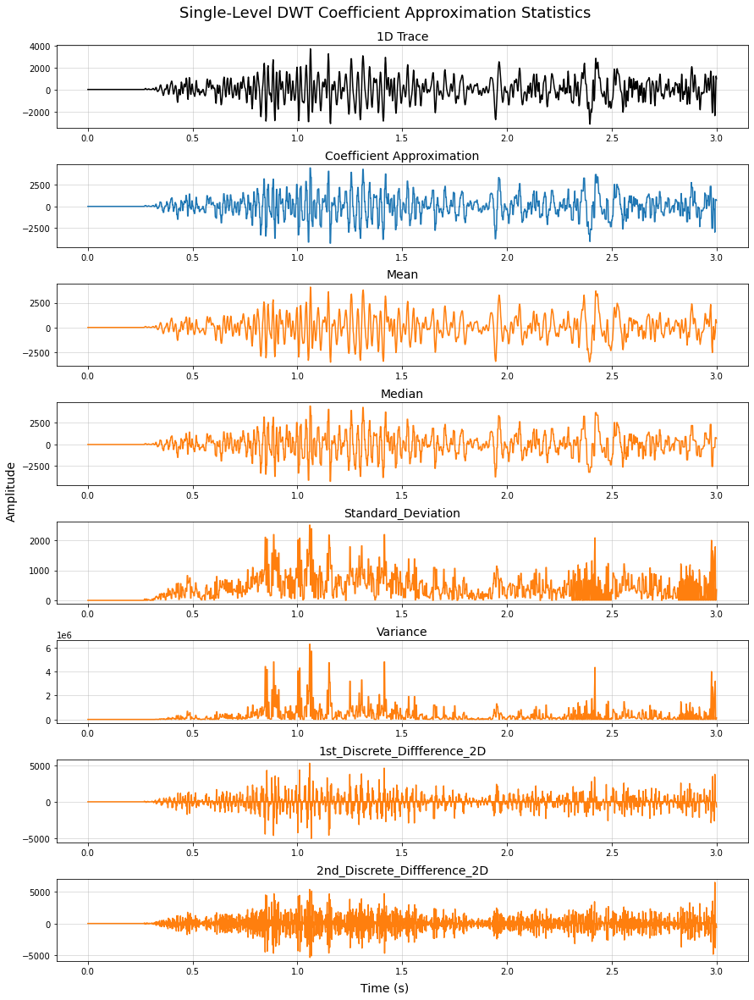

In [163]:
fig, axs = plt.subplots(nrows=8, figsize=(12,16), sharey=False, constrained_layout=True)
for i, ax in enumerate(fig.axes):
    if i == 0:
        ax.plot(time/1e3, signal, color='k')
        ax.set_title('1D Trace', size=14)
    elif i == 1:
        ax.plot(time/1e3, c_lst_r[i-1])
        ax.set_title('Coefficient Approximation', size=14)
    else:
        ax.plot(time/1e3, statistical_features[i-2][0], color='tab:orange')
        ax.set_title('%s' %statistical_features_names[i-2], size=14)
    ax.grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level DWT Coefficient Approximation Statistics', size=18)

Text(0.5, 0.98, 'Single-Level DWT Coefficient Detail Statistics')

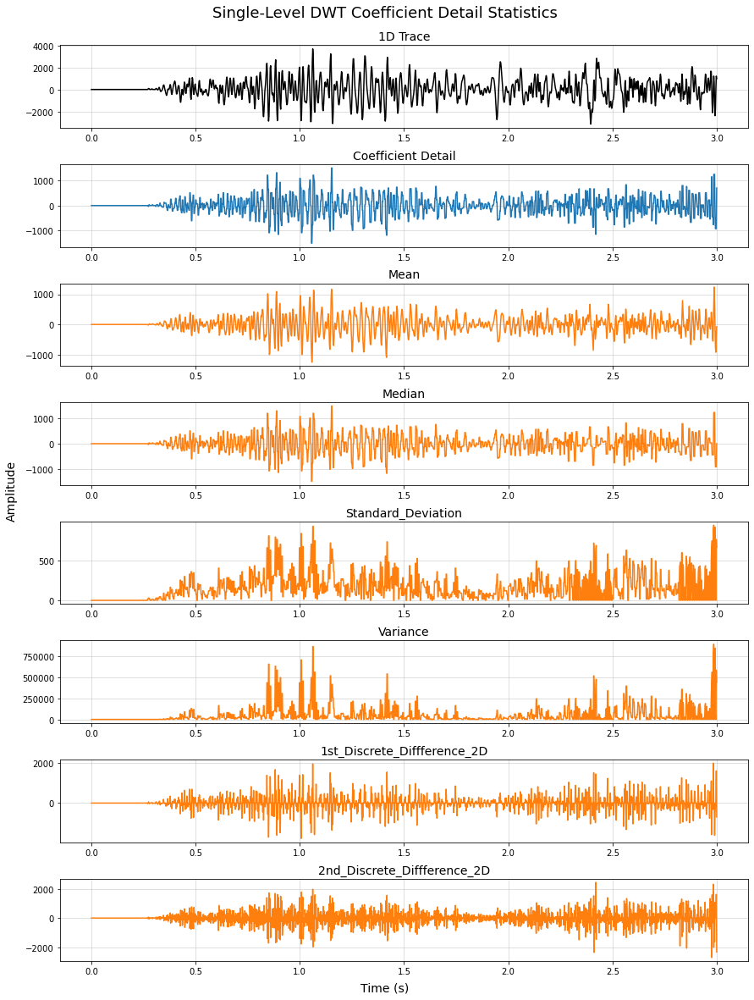

In [164]:
fig, axs = plt.subplots(nrows=8, figsize=(12,16), sharey=False, constrained_layout=True)
for i, ax in enumerate(fig.axes):
    if i == 0:
        ax.plot(time/1e3, signal, color='k')
        ax.set_title('1D Trace', size=14)
    elif i == 1:
        ax.plot(time/1e3, c_lst_r[i])
        ax.set_title('Coefficient Detail', size=14)
    else:
        ax.plot(time/1e3, statistical_features[i-2][1], color='tab:orange')
        ax.set_title('%s' %statistical_features_names[i-2], size=14)
    ax.grid(alpha=0.5)
fig.text(0.5,-0.01, 'Time (s)', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Amplitude', ha='center', va='center', rotation='vertical', size=14)
plt.suptitle('Single-Level DWT Coefficient Detail Statistics', size=18)

### Single Level 2D Details Principal Component

In [165]:
details_2D = [i for i in range(len(c_2D_lst_r[1:]))]

for i in range(len(c_2D_lst_r[1:])):
    details_2D[i] = c_2D_lst_r[1:][i].reshape(-1)

In [166]:
details_2D_df = pd.DataFrame(np.asarray(details_2D).T, columns=c_name_2D[1:])
details_2D_df

,Horizontal (LH),Vertical (HL),Diagonal (HH)
0,134.999908,270.000122,179.999939
1,34.192075,12.379974,79.192102
2,-66.615759,-245.240174,-21.615734
3,-34.192159,-169.781659,-33.602640
4,-0.589520,-91.375546,-44.803520
...,...,...,...
71065,0.000000,0.000000,0.000000
71066,0.000000,0.000000,0.000000
71067,0.000000,0.000000,0.000000
71068,0.000000,0.000000,0.000000


In [167]:
scaled_details_2D = MinMaxScaler().fit_transform(details_2D_df)

In [168]:
print('explained_variance {}'.format(PCA(n_components=3).fit(scaled_details_2D).explained_variance_), '\n'
      'explained_variance_ratio {}'.format(PCA(n_components=3).fit(scaled_details_2D).explained_variance_ratio_), '\n'
      'singular_values {}'.format(PCA(n_components=3).fit(scaled_details_2D).singular_values_))

explained_variance [0.00312912 0.00208964 0.00066769] 
explained_variance_ratio [0.53158056 0.35499074 0.11342871] 
singular_values [14.91253148 12.18639751  6.88855804]


We'll use an explained variance ratio cut-off of 15%

We'll retain the first two principal components which explain 89% of the total variance

In [169]:
PC_details_2D = PCA(n_components=2).fit_transform(scaled_details_2D)

In [170]:
PC_details_2D_df = pd.DataFrame(PC_details_2D, columns=['PC1', 'PC2'])
PC_details_2D_df

,PC1,PC2
0,-0.093344,0.028083
1,-0.003863,0.006737
2,0.085619,-0.014608
3,0.059298,-0.008108
4,0.031953,-0.001362
...,...,...
71065,0.000115,-0.000317
71066,0.000115,-0.000317
71067,0.000115,-0.000317
71068,0.000115,-0.000317


In [171]:
PC_details_2D_lst = []

for i in range(len(PC_details_2D_df.columns)):
    PC_details_2D_lst.append(PC_details_2D_df.iloc[:,i].values)

for i in range(len(PC_details_2D_lst)):
    PC_details_2D_lst[i] = PC_details_2D_lst[i].reshape(c_2D_lst_r[0].shape)

PCA reduces the incohorent signal (high frequency noise) in the detail coefficients

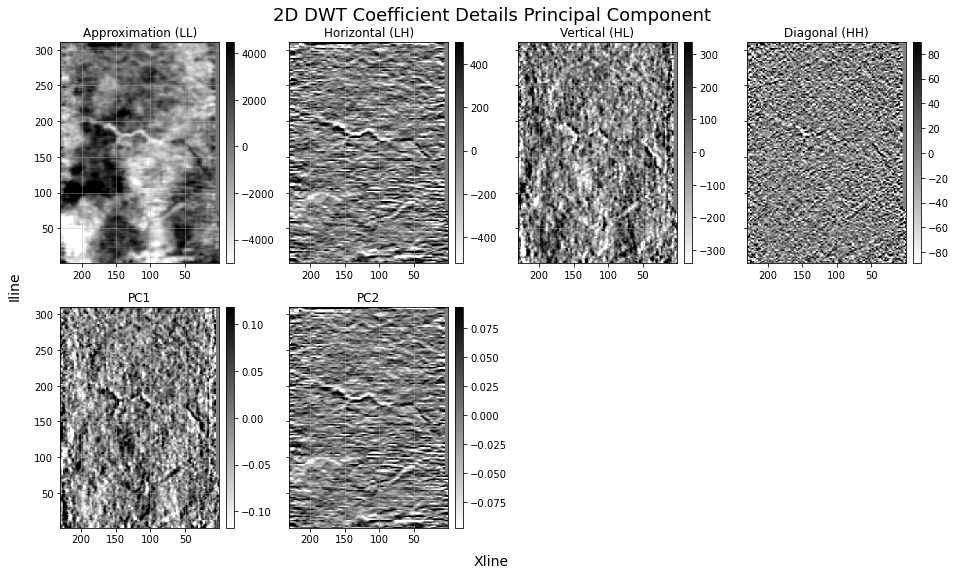

In [172]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(13,7.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
PC_names_2D = ['PC1', 'PC2']
for i, ax in enumerate(fig.axes):
    if i in range(0,4):
        im[i] = ax.pcolormesh(xline_2D, iline_2D, c_2D_lst_r[i], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(c_2D_lst_r[i], 2), 
                              vmax=np.percentile(c_2D_lst_r[i], 98))
        ax.set_title('%s' %c_name_2D[i], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in range(4,6):
        im[i] = ax.pcolormesh(xline_2D, iline_2D, PC_details_2D_lst[i-4], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_2D_lst[i-4], 2), 
                              vmax=np.percentile(PC_details_2D_lst[i-4], 98))
        ax.set_title('%s' %PC_names_2D[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        ax.set_axis_off()
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, '2D DWT Coefficient Details Principal Component', ha='center', va='center', size=18)
plt.tight_layout()

### Single Level 2D Statistical Features 

We'll use a list of the Single-Level Coefficient Approximation and Principal Components of the Coefficient Details

In [173]:
features_2D = []
features_2D.append(c_2D_lst_r[0])
for i in range(len(PC_details_2D_lst)):
    features_2D.append(PC_details_2D_lst[i]) 

In [174]:
statistical_features_2D_names = ['Mean_2D', 'Median_2D', 'Standard_Deviation_2D', 'Variance_2D', 
                                 '1st_H_Diffference_2D', '1st_V_Diffference_2D', '2nd_H_Diffference_2D', '2nd_V_Diffference_2D']

Method: Coefficient > Resample > Principal Components (Details) > Rolling Statistics

In [175]:
mean_2D = []
median_2D = []
std_2D = []
var_2D = []
diff_H_1st_2D = []
diff_V_1st_2D = []
diff_H_2nd_2D = []
diff_V_2nd_2D = []

def stat_feat_2D(coeffs):
    
    for coeff in range(len(coeffs)):
        mean_2D.append(scipy.ndimage.generic_filter(features_2D[coeff], np.nanmean, size=(3,3), mode='constant'))
        median_2D.append(scipy.ndimage.generic_filter(features_2D[coeff], np.nanmedian, size=(3,3), mode='constant'))
        std_2D.append(scipy.ndimage.generic_filter(features_2D[coeff], np.nanstd, size=(3,3), mode='constant'))
        var_2D.append(scipy.ndimage.generic_filter(features_2D[coeff], np.nanvar, size=(3,3), mode='constant'))
        diff_H_1st_2D.append(np.diff(features_2D[coeff], n=1, axis=0, append=0))
        diff_V_1st_2D.append(np.diff(features_2D[coeff], n=1, axis=1, append=0))
        diff_H_2nd_2D.append(np.diff(features_2D[coeff], n=2, axis=0, prepend=np.zeros([1, features_2D[coeff].shape[1]]), 
                                     append=np.zeros([1, features_2D[coeff].shape[1]])))
        diff_V_2nd_2D.append(np.diff(features_2D[coeff], n=2, axis=1, prepend=np.zeros([features_2D[coeff].shape[0], 1]), 
                                     append=np.zeros([features_2D[coeff].shape[0], 1])))
        
    return [mean_2D, median_2D, std_2D, var_2D, diff_H_1st_2D, diff_V_1st_2D, diff_H_2nd_2D, diff_V_2nd_2D]

In [176]:
statistical_features_2D = stat_feat_2D(features_2D)

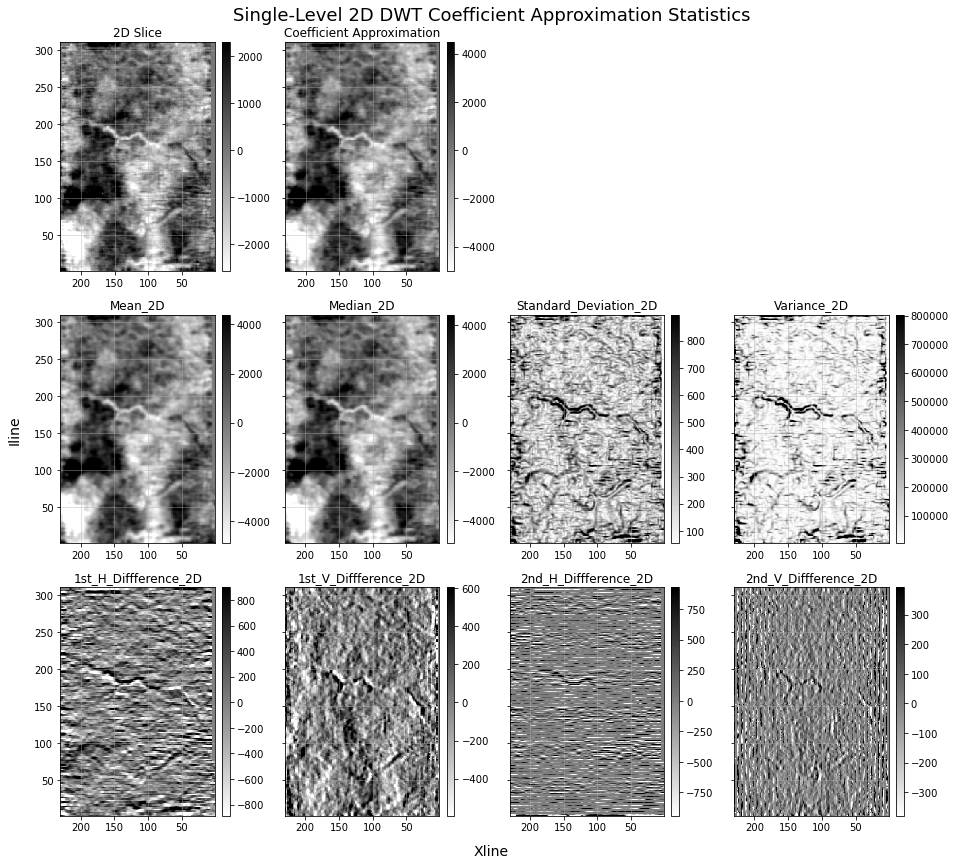

In [177]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, c_2D_lst_r[0], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(c_2D_lst_r[0], 2), 
                              vmax=np.percentile(c_2D_lst_r[0], 98))
        ax.set_title('Coefficient Approximation', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, statistical_features_2D[i-4][0], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(statistical_features_2D[i-4][0], 2), 
                              vmax=np.percentile(statistical_features_2D[i-4][0], 98))
        ax.set_title('%s' %statistical_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Approximation Statistics', ha='center', va='center', size=18)
plt.tight_layout()

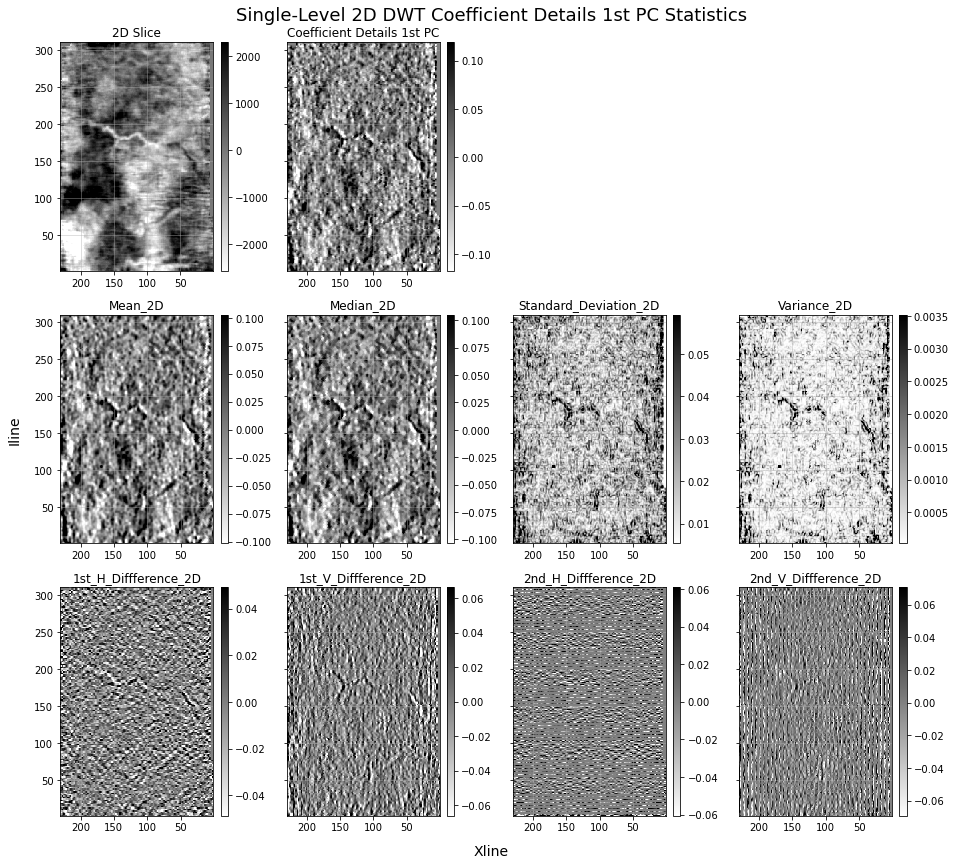

In [178]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, PC_details_2D_lst[i-1], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_2D_lst[i-1], 2), 
                              vmax=np.percentile(PC_details_2D_lst[i-1], 98))
        ax.set_title('Coefficient Details 1st PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, statistical_features_2D[i-4][1], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(statistical_features_2D[i-4][1], 2), 
                              vmax=np.percentile(statistical_features_2D[i-4][1], 98))
        ax.set_title('%s' %statistical_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Details 1st PC Statistics', ha='center', va='center', size=18)
plt.tight_layout()

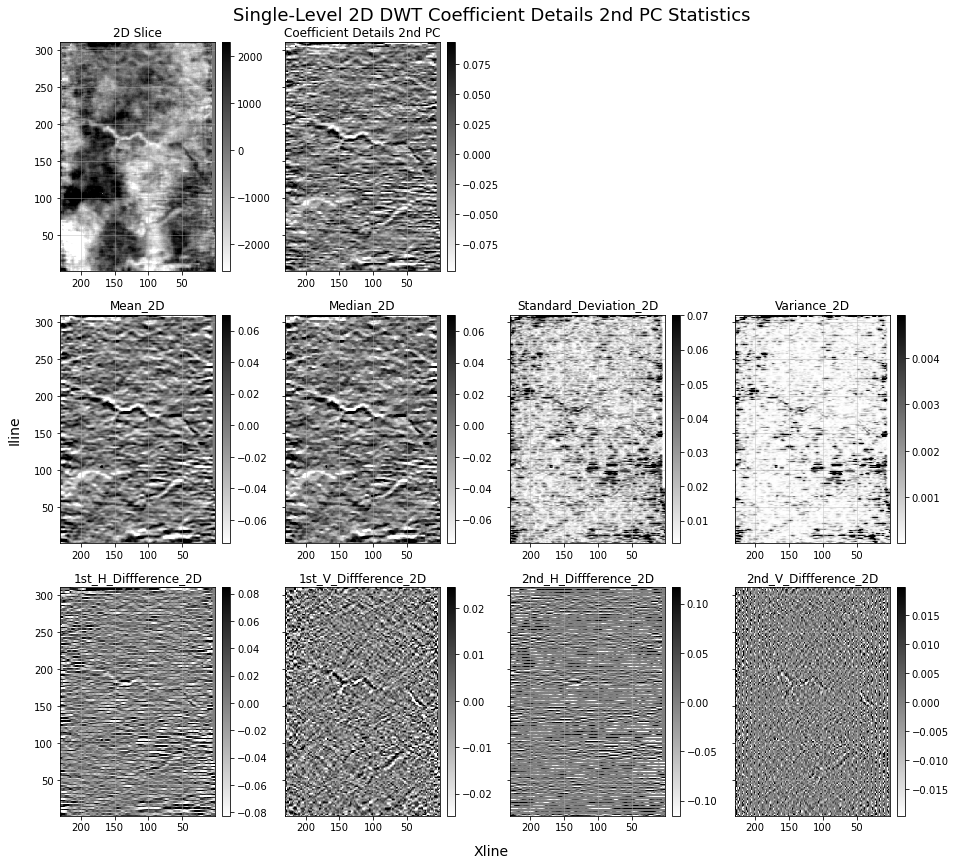

In [179]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11.5), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, PC_details_2D_lst[i], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_2D_lst[i], 2), 
                              vmax=np.percentile(PC_details_2D_lst[i], 98))
        ax.set_title('Coefficient Details 2nd PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, statistical_features_2D[i-4][2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(statistical_features_2D[i-4][2], 2), 
                              vmax=np.percentile(statistical_features_2D[i-4][2], 98))
        ax.set_title('%s' %statistical_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Details 2nd PC Statistics', ha='center', va='center', size=18)
plt.tight_layout()

### Single Level 2D Derivative Features

In [180]:
derivative_features_2D_names = ['Sobel_H_2D', 'Sobel_V_2D', 'Prewitt_H_2D', 'Prewitt_V_2D', 
                                'Scharr_H_2D', 'Scharr_V_2D', 'Farid_H_2D', 'Farid_V_2D', 
                                'Sobel_gdmg_2D', 'Prewitt_gdmg_2D', 'Scharr_gdmg_2D', 'Farid_gdmg_2D', 
                                'Roberts_gdmg_2D', 'Roberts_ND_2D', 'Roberts_PD_2D', 'Canny_2D', 
                                'Gaussian_gdmg_2D', 'Gaussian_2D', 'Gaussian_1st_2D', 'Gaussian_2nd_2D', 
                                'Laplace_2D', 'Gaussian_Laplace_2D', 'Gaussian_1st_Laplace_2D', 'Gauss_2nd_Laplace_2D', 
                                'Sobel_Laplace_2D', 'Prewitt_Laplace_2D']

Method: Coefficient > Resample > Principal Components (Details) > Derivative Filters

In [181]:
sobel_H_2D = []
sobel_V_2D = []
prewitt_H_2D = []
prewitt_V_2D = []
scharr_H_2D = []
scharr_V_2D = []
farid_H_2D = []
farid_V_2D = []
sobel_gdmg_2D = []
prewitt_gdmg_2D = []
scharr_gdmg_2D = []
farid_gdmg_2D = []
roberts_gdmg_2D = []
roberts_ND_2D = []
roberts_PD_2D = []
canny_2D = []
gauss_gdmg_2D = []
gauss_2D = []
gauss_1st_2D = [] 
gauss_2nd_2D = []
laplace_2D = []
gauss_laplace_2D = []
gauss_1st_laplace_2D = []
gauss_2nd_laplace_2D = []
sobel_laplace_2D = []
prewitt_laplace_2D = []

def dev_feat_2D(coeffs):
    
    def dev_sobel(input, axis, output, mode, cval):
        return scipy.ndimage.sobel(input, axis, output, 'constant', cval)
    
    def dev_prewitt(input, axis, output, mode, cval):
        return scipy.ndimage.prewitt(input, axis, output, 'constant', cval)
    
    def dev2_sobel(input, axis, output, mode, cval):
        return scipy.ndimage.sobel(input, axis, output, 'constant', cval)
    
    def dev2_prewitt(input, axis, output, mode, cval):
        return scipy.ndimage.prewitt(input, axis, output, 'constant', cval)
    
    def dev2_gauss(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)
    
    def dev2_gauss_1st(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)
    
    def dev2_gauss_2nd(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)
    
    for coeff in range(len(coeffs)):
        sobel_H_2D.append(scipy.ndimage.sobel(features_2D[coeff], axis=0, mode='constant'))
        sobel_V_2D.append(scipy.ndimage.sobel(features_2D[coeff], axis=1, mode='constant'))
        prewitt_H_2D.append(scipy.ndimage.prewitt(features_2D[coeff], axis=0, mode='constant'))
        prewitt_V_2D.append(scipy.ndimage.prewitt(features_2D[coeff], axis=1, mode='constant'))
        scharr_H_2D.append(skimage.filters.scharr_h(features_2D[coeff]))
        scharr_V_2D.append(skimage.filters.scharr_v(features_2D[coeff]))
        farid_H_2D.append(skimage.filters.farid_h(features_2D[coeff]))
        farid_V_2D.append(skimage.filters.farid_v(features_2D[coeff]))
        sobel_gdmg_2D.append(scipy.ndimage.generic_gradient_magnitude(features_2D[coeff], dev_sobel, mode='constant'))
        prewitt_gdmg_2D.append(scipy.ndimage.generic_gradient_magnitude(features_2D[coeff], dev_prewitt, mode='constant'))
        scharr_gdmg_2D.append(skimage.filters.scharr(features_2D[coeff], mode='constant'))
        farid_gdmg_2D.append(skimage.filters.farid(features_2D[coeff]))
        roberts_gdmg_2D.append(skimage.filters.roberts(features_2D[coeff]))
        roberts_ND_2D.append(skimage.filters.roberts_neg_diag(features_2D[coeff]))
        roberts_PD_2D.append(skimage.filters.roberts_pos_diag(features_2D[coeff]))
        canny_2D.append(skimage.feature.canny(features_2D[coeff], sigma=3, low_threshold=np.percentile(features_2D[coeff], 70), 
                                                high_threshold=np.percentile(features_2D[coeff], 80)))
        gauss_gdmg_2D.append(scipy.ndimage.gaussian_gradient_magnitude(features_2D[coeff], sigma=(1,1), mode='constant'))
        gauss_2D.append(scipy.ndimage.gaussian_filter(features_2D[coeff], sigma=(1,1), order=0, mode='constant'))
        gauss_1st_2D.append(scipy.ndimage.gaussian_filter(features_2D[coeff], sigma=(1,1), order=1, mode='constant'))
        gauss_2nd_2D.append(scipy.ndimage.gaussian_filter(features_2D[coeff], sigma=(1,1), order=2, mode='constant'))
        laplace_2D.append(scipy.ndimage.laplace(features_2D[coeff], mode='constant'))
        gauss_laplace_2D.append(scipy.ndimage.generic_laplace(features_2D[coeff], dev2_gauss, mode='constant', 
                                                                extra_keywords={'sigma': 1, 'order': 0}))
        gauss_1st_laplace_2D.append(scipy.ndimage.generic_laplace(features_2D[coeff], dev2_gauss_1st, mode='constant', 
                                                                    extra_keywords={'sigma': 1, 'order': 1}))
        gauss_2nd_laplace_2D.append(scipy.ndimage.generic_laplace(features_2D[coeff], dev2_gauss_2nd, mode='constant', 
                                                                    extra_keywords={'sigma': 1, 'order': 2}))
        sobel_laplace_2D.append(scipy.ndimage.generic_laplace(features_2D[coeff], dev2_sobel, mode='constant'))
        prewitt_laplace_2D.append(scipy.ndimage.generic_laplace(features_2D[coeff], dev2_prewitt, mode='constant'))
        
    return [sobel_H_2D, sobel_V_2D, prewitt_H_2D, prewitt_V_2D, 
            scharr_H_2D, scharr_V_2D, farid_H_2D, farid_V_2D, 
            sobel_gdmg_2D, prewitt_gdmg_2D, scharr_gdmg_2D, farid_gdmg_2D, 
            roberts_gdmg_2D, roberts_ND_2D, roberts_PD_2D, canny_2D, 
            gauss_gdmg_2D, gauss_2D, gauss_1st_2D, gauss_2nd_2D, 
            laplace_2D, gauss_laplace_2D, gauss_1st_laplace_2D, gauss_2nd_laplace_2D, 
            sobel_laplace_2D, prewitt_laplace_2D]

In [182]:
derivative_features_2D = dev_feat_2D(features_2D)

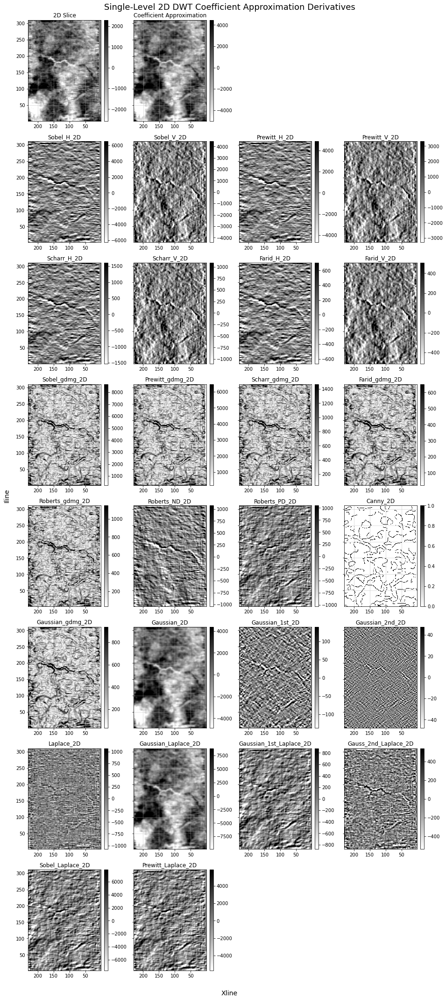

In [183]:
fig, axs = plt.subplots(nrows=8, ncols=4, figsize=(13,29), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, c_2D_lst_r[0], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(c_2D_lst_r[0], 2), 
                              vmax=np.percentile(c_2D_lst_r[0], 98))
        ax.set_title('Coefficient Approximation', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3,30,31]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, derivative_features_2D[i-4][0], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_2D[i-4][0], 2), 
                              vmax=np.percentile(derivative_features_2D[i-4][0], 98))
        ax.set_title('%s' %derivative_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Approximation Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

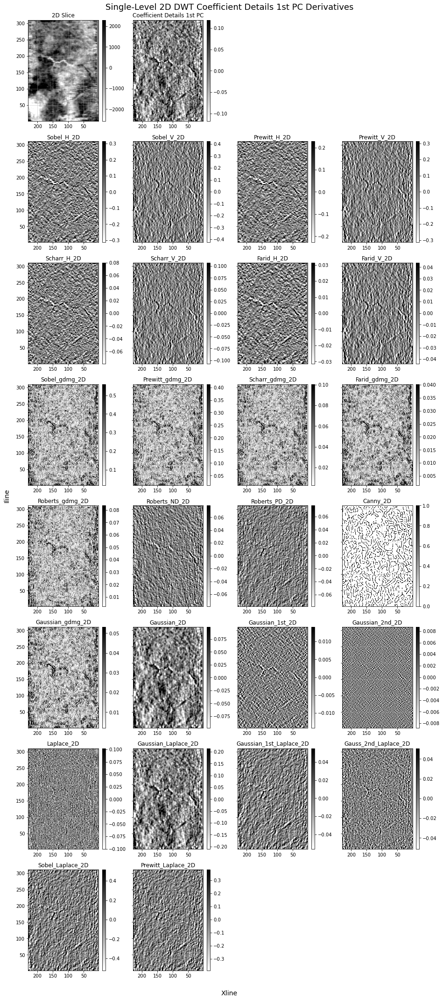

In [184]:
fig, axs = plt.subplots(nrows=8, ncols=4, figsize=(13,29), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, PC_details_2D_lst[i-1], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_2D_lst[i-1], 2), 
                              vmax=np.percentile(PC_details_2D_lst[i-1], 98))
        ax.set_title('Coefficient Details 1st PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3,30,31]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, derivative_features_2D[i-4][1], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_2D[i-4][1], 2), 
                              vmax=np.percentile(derivative_features_2D[i-4][1], 98))
        ax.set_title('%s' %derivative_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Details 1st PC Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

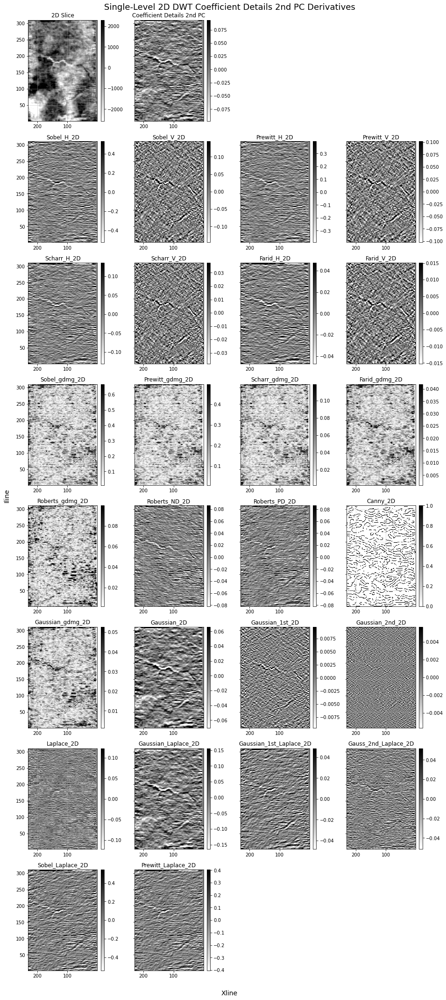

In [185]:
fig, axs = plt.subplots(nrows=8, ncols=4, figsize=(13,29), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, signal_2D, shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_2D, 2), 
                              vmax=np.percentile(signal_2D, 98))
        ax.set_title('2D Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, PC_details_2D_lst[i], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_2D_lst[i], 2), 
                              vmax=np.percentile(PC_details_2D_lst[i], 98))
        ax.set_title('Coefficient Details 2nd PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3,30,31]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_2D, iline_2D, derivative_features_2D[i-4][2], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_2D[i-4][2], 2), 
                              vmax=np.percentile(derivative_features_2D[i-4][2], 98))
        ax.set_title('%s' %derivative_features_2D_names[i-4], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 2D DWT Coefficient Details 2nd PC Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

### Single Level 3D Details Principal Component

In [186]:
details_3D = [i for i in range(len(c_3D_vlst_r[1:]))]

for i in range(len(c_3D_vlst_r[1:])):
    details_3D[i] = c_3D_vlst_r[1:][i].reshape(-1)

In [187]:
details_3D_df = pd.DataFrame(np.asarray(details_3D).T, columns=c_3D_klst[1:])
details_3D_df

,aad,ada,add,daa,dad,dda,ddd
0,1.321760e-29,-1.910192e-28,-1.336195e-28,3.646803e-28,-5.493406e-30,-1.544855e-28,-1.312350e-28
1,-5.489586e-28,1.088903e-27,8.532974e-28,4.925130e-28,1.486240e-28,4.727226e-29,9.944632e-30
2,6.054613e-29,2.381656e-27,1.893760e-27,1.107502e-27,5.435167e-28,-8.667010e-28,-1.212605e-27
3,6.449208e-29,-8.228741e-27,7.475351e-28,-3.037892e-27,5.127262e-29,1.997657e-27,-8.277079e-28
4,1.819351e-30,-7.266822e-27,1.663047e-27,-2.001457e-28,2.000880e-28,-1.388420e-27,-3.234965e-28
...,...,...,...,...,...,...,...
106676065,5.082323e-14,-1.825934e-14,1.796017e-14,-1.928602e-13,8.275609e-16,-9.098481e-14,3.207369e-14
106676066,4.074794e-14,-2.877172e-14,6.920747e-15,-1.883573e-13,-2.200231e-14,-8.528199e-14,-7.259721e-15
106676067,4.229442e-14,-1.193050e-14,-1.788565e-15,-7.230937e-14,-6.081993e-14,-3.082777e-14,-3.976089e-14
106676068,4.887287e-14,2.891570e-15,3.872562e-14,9.411120e-14,5.046431e-14,4.516451e-14,1.978320e-14


In [188]:
scaled_details_3D = MinMaxScaler().fit_transform(details_3D_df)

In [189]:
print('explained_variance {}'.format(PCA(n_components=7).fit(scaled_details_3D).explained_variance_), '\n'
      'explained_variance_ratio {}'.format(PCA(n_components=7).fit(scaled_details_3D).explained_variance_ratio_), '\n'
      'singular_values {}'.format(PCA(n_components=7).fit(scaled_details_3D).singular_values_))

explained_variance [0.00137859 0.0011948  0.00087072 0.00064098 0.00054508 0.00047352
 0.00043184] 
explained_variance_ratio [0.24904485 0.21584163 0.157296   0.11579342 0.09846953 0.08554217
 0.07801239] 
singular_values [383.48785 357.01004 304.76962 261.4898  241.13695 224.7517  214.63208]


We'll use an explained variance ratio cut-off of 15%

We'll retain the first three principal components which explain 62% of the total variance

In [190]:
PC_details_3D = PCA(n_components=3).fit_transform(scaled_details_3D)

In [191]:
PC_details_3D_df = pd.DataFrame(PC_details_3D, columns=['PC1', 'PC2', 'PC3'])
PC_details_3D_df

,PC1,PC2,PC3
0,0.119666,0.037516,-0.027754
1,-0.006056,0.002151,0.022172
2,0.000857,-0.000730,0.004500
3,-0.001018,0.001117,0.005475
4,0.000798,-0.001480,0.007210
...,...,...,...
106676065,0.000004,0.000059,0.000038
106676066,0.000004,0.000059,0.000038
106676067,0.000004,0.000059,0.000038
106676068,0.000004,0.000059,0.000038


In [192]:
PC_details_3D_lst = []

for i in range(len(PC_details_3D_df.columns)):
    PC_details_3D_lst.append(PC_details_3D_df.iloc[:,i].values)

for i in range(len(PC_details_3D_lst)):
    PC_details_3D_lst[i] = PC_details_3D_lst[i].reshape(c_3D_vlst_r[0].shape)

PCA reduces the incohorent signal (high frequency noise) in the detail coefficients

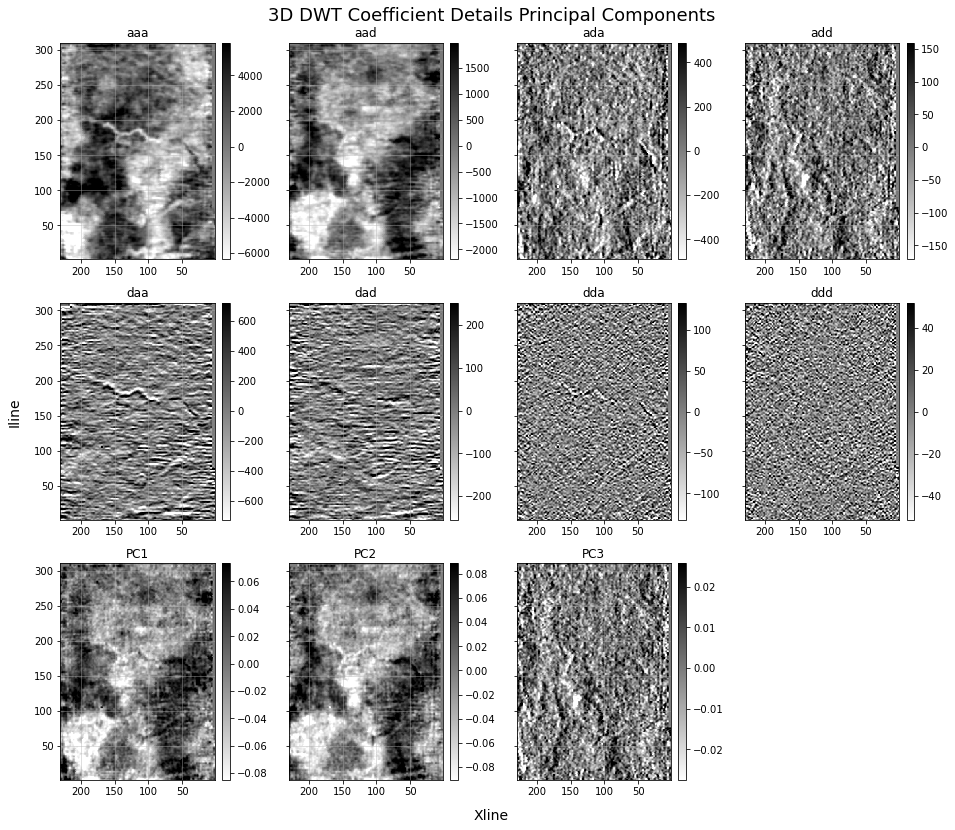

In [193]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(13,11), sharey=True)
im = [i for i in enumerate(fig.axes)]
PC_names_3D = ['PC1', 'PC2', 'PC3']
for i, ax in enumerate(fig.axes):
    if i in range(0,8):
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], c_3D_vlst_r[i][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(c_3D_vlst_r[i][:,:,421], 2), 
                              vmax=np.percentile(c_3D_vlst_r[i][:,:,421], 98))
        ax.set_title('%s' %c_3D_klst[i], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in range(8,11):
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], PC_details_3D_lst[i-8][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_3D_lst[i-8][:,:,421], 2), 
                              vmax=np.percentile(PC_details_3D_lst[i-8][:,:,421], 98))
        ax.set_title('%s' %PC_names_3D[i-8], size=12)
        ax.set_xlim(1,230)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    else:
        ax.set_axis_off()
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, '3D DWT Coefficient Details Principal Components', ha='center', va='center', size=18)
plt.tight_layout()

### Single Level 3D Derivative Features

We'll use a list of the Single-Level Coefficient Approximation and Principal Components of the Coefficient Details

In [194]:
features_3D = []
features_3D.append(c_3D_vlst_r[0])
for i in range(len(PC_details_3D_lst)):
    features_3D.append(PC_details_3D_lst[i]) 

In [195]:
derivative_features_3D_names = ['Sobel_gdmg_3D', 'Sobel_H_3D', 'Sobel_V_3D', 'Sobel_Laplace_3D', 
                                'Gaussian_gdmg_3D', 'Gaussian_3D', 'Gaussian_1st_3D', 'Gaussian_2nd_3D', 
                                'Laplace_3D', 'Gaussian_Laplace_3D', 'Gaussian_1st_Laplace_3D', 'Gauss_2nd_Laplace_3D']

Method: Coefficient > Resample > Principal Components (Details) > Derivative Filters

In [196]:
sobel_gdmg_3D = []
sobel_H_3D = []
sobel_V_3D = []
sobel_laplace_3D = []
gauss_gdmg_3D = []
gauss_3D = []
gauss_1st_3D = []
gauss_2nd_3D = []
laplace_3D = []
gauss_laplace_3D = []
gauss_1st_laplace_3D = []
gauss_2nd_laplace_3D = []

def dev_feat_3D(coeffs):
    
    def dev_sobel(input, axis, output, mode, cval):
        return scipy.ndimage.sobel(input, axis, output, 'constant', cval)

    def dev2_sobel(input, axis, output, mode, cval):
        return scipy.ndimage.sobel(input, axis, output, 'constant', cval)

    def dev2_gauss(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)

    def dev2_gauss_1st(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)

    def dev2_gauss_2nd(input, axis, output, mode, cval, sigma, order):
        return scipy.ndimage.gaussian_filter1d(input, sigma, axis, order, output, 'constant', cval)

    for coeff in range(len(coeffs)):        
        sobel_gdmg_3D.append(scipy.ndimage.generic_gradient_magnitude(features_3D[coeff], dev_sobel, mode='constant'))
        sobel_H_3D.append(scipy.ndimage.sobel(features_3D[coeff], axis=0, mode='constant'))
        sobel_V_3D.append(scipy.ndimage.sobel(features_3D[coeff], axis=1, mode='constant'))
        sobel_laplace_3D.append(scipy.ndimage.generic_laplace(features_3D[coeff], dev2_sobel, mode='constant'))
        gauss_gdmg_3D.append(scipy.ndimage.gaussian_gradient_magnitude(features_3D[coeff], sigma=(1,1,1), mode='constant'))
        gauss_3D.append(scipy.ndimage.gaussian_filter(features_3D[coeff], sigma=(1,1,1), order=0, mode='constant'))
        gauss_1st_3D.append(scipy.ndimage.gaussian_filter(features_3D[coeff], sigma=(1,1,1), order=1, mode='constant'))
        gauss_2nd_3D.append(scipy.ndimage.gaussian_filter(features_3D[coeff], sigma=(1,1,1), order=2, mode='constant'))
        laplace_3D.append(scipy.ndimage.laplace(features_3D[coeff], mode='constant'))
        gauss_laplace_3D.append(scipy.ndimage.generic_laplace(features_3D[coeff], dev2_gauss, mode='constant', 
                                                           extra_keywords={'sigma': 1, 'order': 0}))
        gauss_1st_laplace_3D.append(scipy.ndimage.generic_laplace(features_3D[coeff], dev2_gauss_1st, mode='constant', 
                                                               extra_keywords={'sigma': 1, 'order': 1}))
        gauss_2nd_laplace_3D.append(scipy.ndimage.generic_laplace(features_3D[coeff], dev2_gauss_2nd, mode='constant', 
                                                               extra_keywords={'sigma': 1, 'order': 2}))

    return [sobel_gdmg_3D, sobel_H_3D, sobel_V_3D, sobel_laplace_3D, 
            gauss_gdmg_3D, gauss_3D, gauss_1st_3D, gauss_2nd_3D, 
            laplace_3D, gauss_laplace_3D, gauss_1st_laplace_3D, gauss_2nd_laplace_3D]

In [197]:
derivative_features_3D = dev_feat_3D(features_3D)

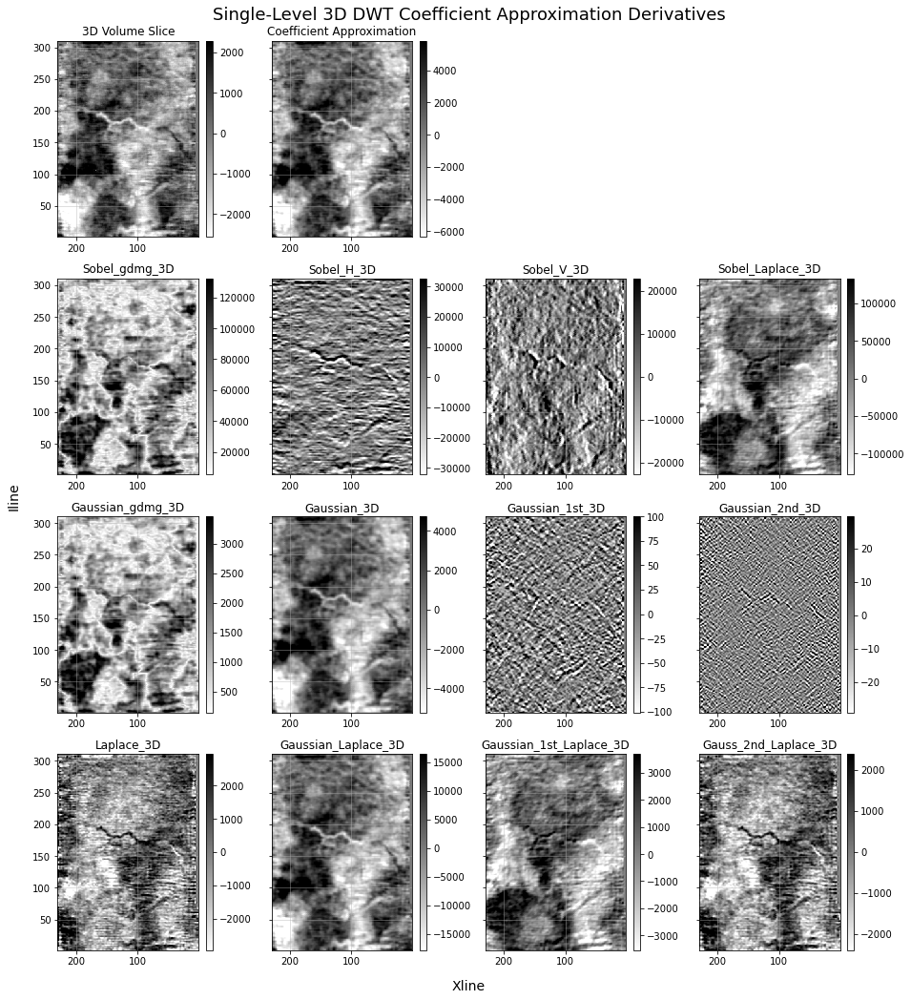

In [198]:
fig, axs = plt.subplots(nrows=4, ncols=4, figsize=(13,14), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_3D[:,:,421], 2), 
                              vmax=np.percentile(signal_3D[:,:,421], 98))
        ax.set_title('3D Volume Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], c_3D_vlst_r[0][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(c_3D_vlst_r[0][:,:,421], 2), 
                              vmax=np.percentile(c_3D_vlst_r[0][:,:,421], 98))
        ax.set_title('Coefficient Approximation', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], derivative_features_3D[i-4][0][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_3D[i-4][0][:,:,421], 2), 
                              vmax=np.percentile(derivative_features_3D[i-4][0][:,:,421], 98))
        ax.set_title('%s' %derivative_features_3D_names[i-4], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 3D DWT Coefficient Approximation Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

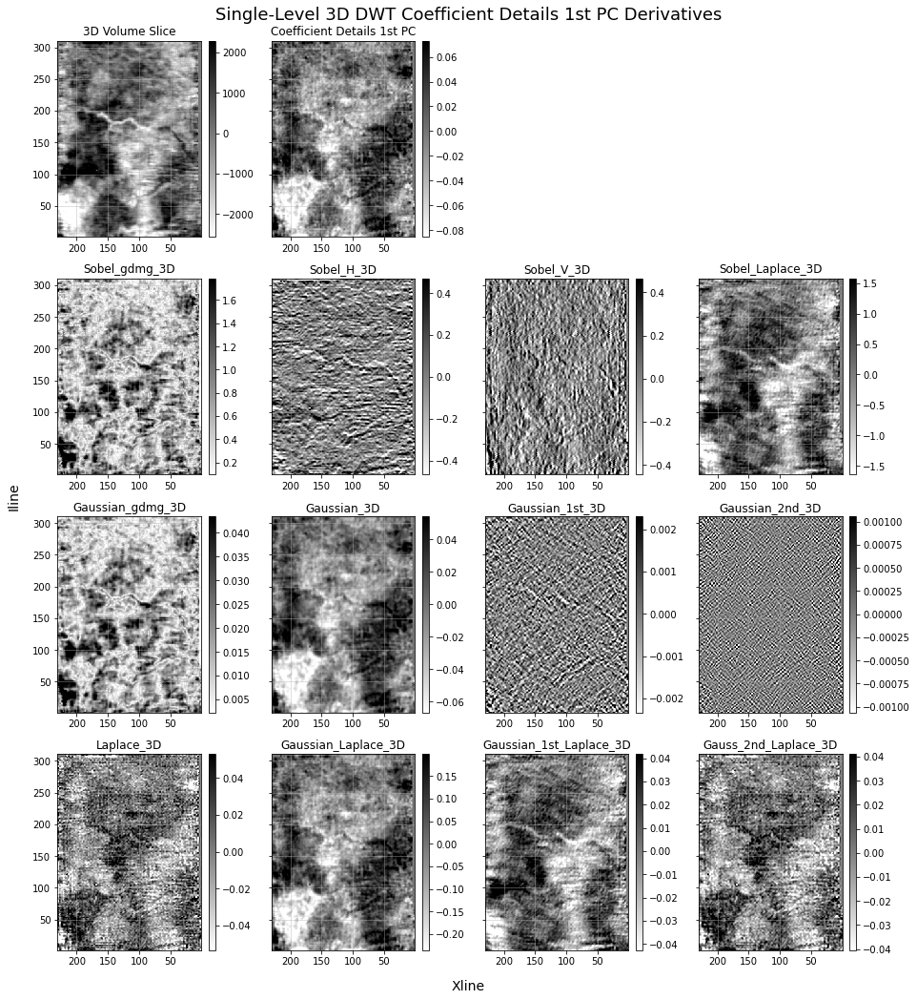

In [199]:
fig, axs = plt.subplots(nrows=4, ncols=4, figsize=(13,14), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_3D[:,:,421], 2), 
                              vmax=np.percentile(signal_3D[:,:,421], 98))
        ax.set_title('3D Volume Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], PC_details_3D_lst[i-1][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_3D_lst[i-1][:,:,421], 2), 
                              vmax=np.percentile(PC_details_3D_lst[i-1][:,:,421], 98))
        ax.set_title('Coefficient Details 1st PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], derivative_features_3D[i-4][1][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_3D[i-4][1][:,:,421], 2), 
                              vmax=np.percentile(derivative_features_3D[i-4][1][:,:,421], 98))
        ax.set_title('%s' %derivative_features_3D_names[i-4], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 3D DWT Coefficient Details 1st PC Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

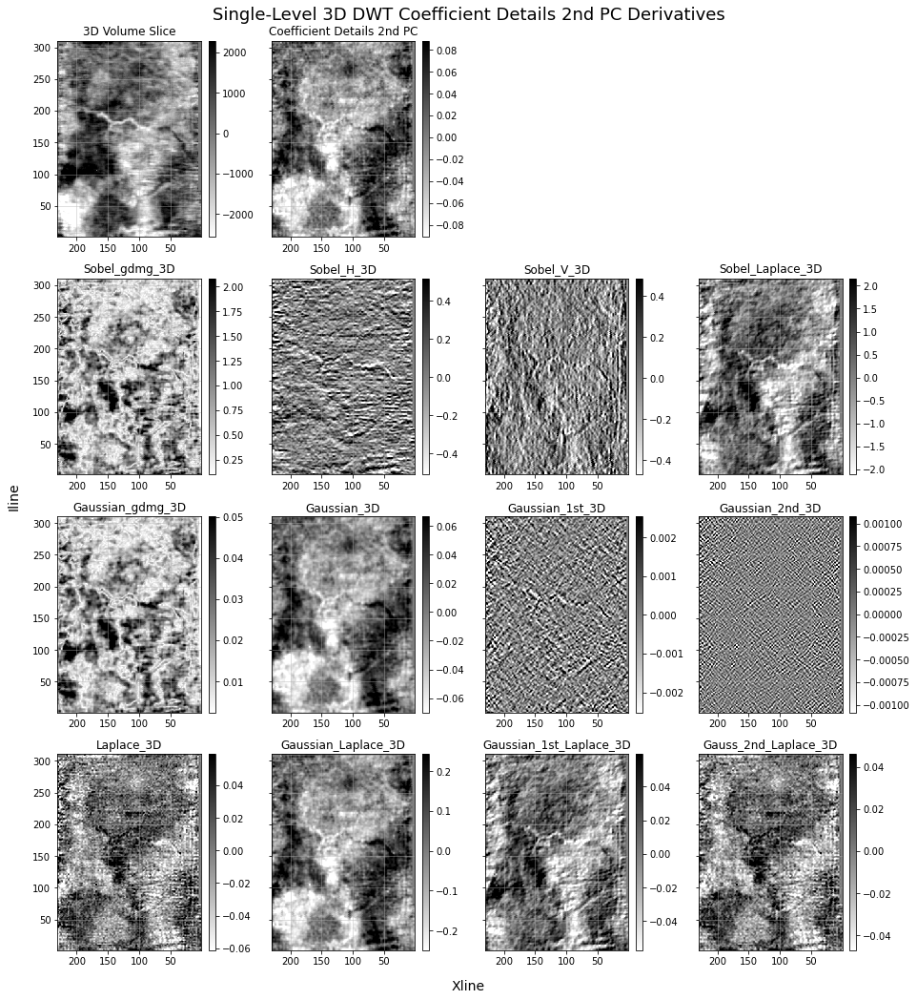

In [200]:
fig, axs = plt.subplots(nrows=4, ncols=4, figsize=(13,14), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_3D[:,:,421], 2), 
                              vmax=np.percentile(signal_3D[:,:,421], 98))
        ax.set_title('3D Volume Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], PC_details_3D_lst[i][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_3D_lst[i][:,:,421], 2), 
                              vmax=np.percentile(PC_details_3D_lst[i][:,:,421], 98))
        ax.set_title('Coefficient Details 2nd PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], derivative_features_3D[i-4][2][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_3D[i-4][2][:,:,421], 2), 
                              vmax=np.percentile(derivative_features_3D[i-4][2][:,:,421], 98))
        ax.set_title('%s' %derivative_features_3D_names[i-4], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 3D DWT Coefficient Details 2nd PC Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

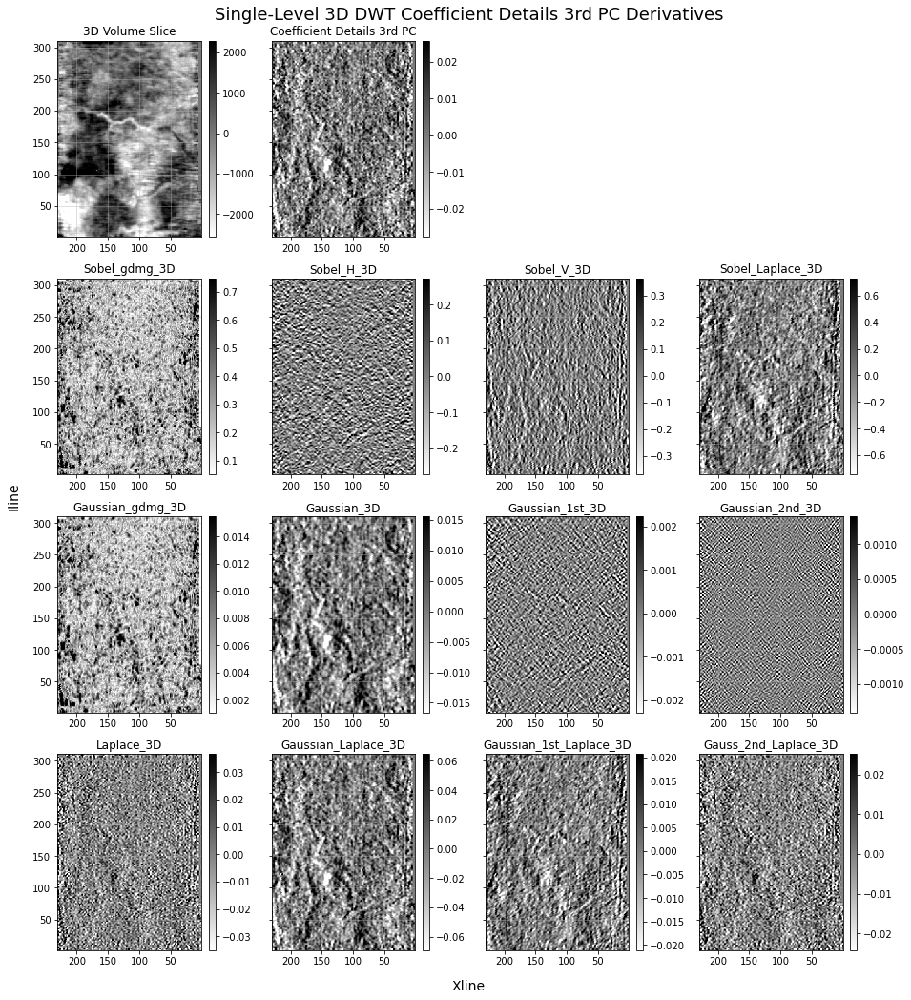

In [201]:
fig, axs = plt.subplots(nrows=4, ncols=4, figsize=(13,14), sharey=True)
im = [i for i in enumerate(fig.axes)]
for i, ax in enumerate(fig.axes):
    if i == 0:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], signal_3D[:,:,421], shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(signal_3D[:,:,421], 2), 
                              vmax=np.percentile(signal_3D[:,:,421], 98))
        ax.set_title('3D Volume Slice', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i == 1:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], PC_details_3D_lst[i+1][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(PC_details_3D_lst[i+1][:,:,421], 2), 
                              vmax=np.percentile(PC_details_3D_lst[i+1][:,:,421], 98))
        ax.set_title('Coefficient Details 3rd PC', size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    elif i in [2,3]:
        ax.set_axis_off()
    else:
        im[i] = ax.pcolormesh(xline_3D[:,:,421], iline_3D[:,:,421], derivative_features_3D[i-4][3][:,:,421], 
                              shading='auto', cmap=plt.cm.gray_r, 
                              vmin=np.percentile(derivative_features_3D[i-4][3][:,:,421], 2), 
                              vmax=np.percentile(derivative_features_3D[i-4][3][:,:,421], 98))
        ax.set_title('%s' %derivative_features_3D_names[i-4], size=12)
        cax = make_axes_locatable(ax).append_axes('right', size='5%', pad=0.1)
        fig.colorbar(im[i], ax=ax, cax=cax)
    ax.grid(alpha=0.5)
    ax.invert_xaxis()
fig.text(0.5,-0.01, 'Xline', ha='center', va='center', size=14)
fig.text(-0.01,0.5, 'Iline', ha='center', va='center', rotation='vertical', size=14)
fig.text(0.5,1.0, 'Single-Level 3D DWT Coefficient Details 3rd PC Derivatives', ha='center', va='center', size=18)
plt.tight_layout()

### References:
1). PyWavelets Library - https://pywavelets.readthedocs.io/en/latest/index.html

2). Scipy Library - https://docs.scipy.org/doc/scipy-1.6.1/reference/

3). Scikit Library - https://scikit-image.org/docs/stable/api/skimage.html

4). Scikit-image Library - https://scikit-learn.org/stable/index.html